# Constant v_t - pristine update all levels - 5

In [21]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'
from matplotlib.pylab import *
from IPython import display
rcParams['figure.figsize'] = (12,8)
rcParams['font.size'] = 20
import logging

In [22]:
import pynbody
import pynbody.plot.sph as sph
import mmap
import gc
import sys, os, glob, pickle
pynbody.ramses.multiprocess_num = 4
pynbody.config['number_of_threads'] = 64

In [23]:
import matplotlib.pyplot as plt 

In [25]:
gc.collect()

0

In [ ]:
s = pynbody.load('output_00008') # 08 -> z = 18.0
#s['pos']
s['pos'] -= 0.5
s.physical_units();

INFO:pynbody:Loading using backend <class 'pynbody.snapshot.ramses.RamsesSnap'>


In [ ]:
z = 1/s.properties['a']-1
print "Redshift =",z
boxsizestring = "%.2f" % s.properties['boxsize'].in_units('kpc')
boxsizestring += " kpc"
print boxsizestring

In [7]:
# just once per snap
s.derivable_keys()[1:5]
pynbody.analysis.ramses_util.get_tform(s,"/Users/earnric/bin/part2birth");

In [19]:
s.properties

{'a': 0.0526327038885262,
 'boxsize': Unit("2.22e+02 kpc"),
 'h': 0.71,
 'omegaL0': 0.732999980449677,
 'omegaM0': 0.266999989748001,
 'time': Unit("2.19e-01 kpc s km**-1")}

In [9]:
s.g['metal'][s.g['metal']<1e-7] = 0.0
s.g['pzf'][s.g['pzf']<1e-7] = 0.0
s.g['pgf'][s.g['pgf']>1.0 - 1e-7] = 1.0
s.g['pgf'][s.g['pgf']<0.0] = 0.0

s.s['metal'][s.s['metal']<1e-7] = 0.0
s.s['pzf'][s.s['pzf']<1e-7] = 0.0
s.s['ppf'][s.s['ppf']>1.0 - 1e-7] = 1.0
s.s['ppf'][s.s['ppf']<0.0] = 0.0

(1e-07, 1)

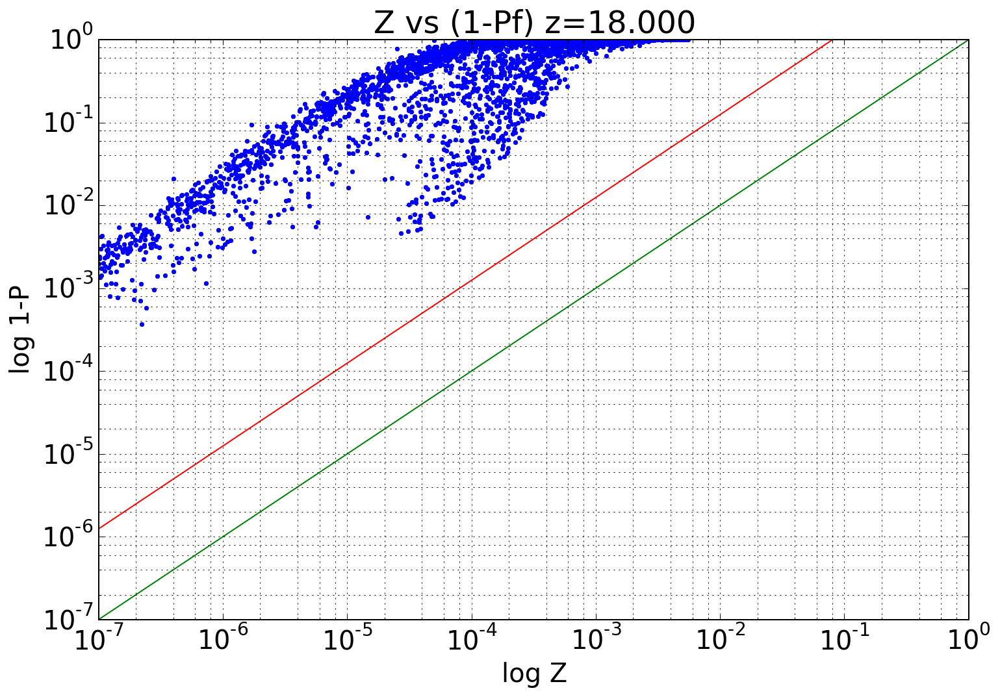

In [10]:
linex=(1e-7,1)
liney=(1e-7*12.45144,12.45144) # Y coords of line with slope 12.4514423189731
plt.loglog(s.g['metal'],1.0-s.g['pgf'],'.',linex,linex,linex,liney)
plt.title("Z vs (1-Pf) z=%.3f"%z)
plt.grid(True, which="both")
axes().set_xlabel("log Z")
axes().set_ylabel("log 1-P")
plt.ylim(1e-7, 1)
plt.xlim(1e-7, 1)

In [11]:
    x,y,zz = - s.s['pos'][len(s.s)-1] # Get the last one
    bs = float(s.properties['boxsize'])
    sbox = 3.0
    if (abs(x) > bs/2.0 - sbox):
        x = np.sign(x) * (bs/2.0 - sbox)
    if (abs(y) > bs/2.0 - sbox):
        y = np.sign(y) * (bs/2.0 - sbox)
    if (abs(zz) > bs/2.0 - sbox):
        zz = np.sign(zz) * (bs/2.0 - sbox)
    
    # Create the base name for plots
    plotfile = "300kpc_z%.1lf"%z
    coords2= [x,y,zz] # NOTE WE ARE TRANSLATING... Note quite center, but the SN is at the edge of the box!
    smallbox= str(sbox) + ' kpc'
    print smallbox
    print coords2

3.0 kpc
[-45.291940221668526, 33.096141781447962, -96.968349902432735]


In [13]:
snBlast = s[pynbody.filt.Cuboid("-48.9 kpc", "30.0 kpc","-99.0 kpc",
                                 "42.4 kpc", "36.05 kpc", "93.6 kpc")]
snBlast.g['velMag']=sqrt(snBlast.g['vx']**2+snBlast.g['vy']**2+snBlast.g['vz']**2)

In [14]:
snBlast.g['pol']=1.0-snBlast.g['pgf']

In [20]:
with pynbody.transformation.translate(snBlast,coords2):
    titleStr = "$v_{t}$ - z = %.1lf" % z + "\ncoords %s"%str(coords2)
    sph.image(snBlast.g,qty="tv",width=boxsizestring,cmap="nipy_spectral", denoise=True ,av_z=False, log=True, 
              approximate_fast=False,title=titleStr,filename="v_t-z = %.1lf std" % z + " @ %s"%str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()

INFO:pynbody.sph:Rendering image on 64 threads...
INFO:pynbody.sph:Rendering image on 64 threads...


ValueError: Failed to make a sensible logarithmic image. This probably means there are no particles in the view.

In [15]:
with pynbody.transformation.translate(snBlast,coords2):
    titleStr = "Z - z = %.1lf" % z + "\ncoords %s"%str(coords2)
    sph.image(snBlast.g,qty="metal",width=smallbox,cmap="nipy_spectral", denoise=True ,av_z=False, log=True, vmax=1,vmin=1e-7,
              approximate_fast=False,title=titleStr,filename="Z-z = %.1lf std" % z + " @ %s" % str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()
    titleStr = "PGF - z = %.1lf" % z + "\ncoords %s"%str(coords2)
    sph.image(snBlast.g,qty="pgf",width=smallbox,cmap="nipy_spectral", denoise=True ,av_z=False, log=True, vmin=1e-7,
              approximate_fast=False,title=titleStr,filename="PGF-z = %.1lf std" % z + " @ %s"%str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()
    titleStr = "Polluted - z = %.1lf" % z + "\ncoords %s"%str(coords2)
    sph.image(snBlast.g,qty="pol",width=smallbox,cmap="nipy_spectral", denoise=True ,av_z=False, log=True, vmin=1e-7,
              approximate_fast=False,title=titleStr,filename="Polluted-z = %.1lf std" % z + " @ %s"%str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()
    titleStr = "$v_{t}$ - z = %.1lf" % z + "\ncoords %s"%str(coords2)
    sph.image(snBlast.g,qty="tv",width=smallbox,cmap="nipy_spectral", denoise=True ,av_z=False, log=True, 
              approximate_fast=False,title=titleStr,filename="v_t-z = %.1lf std" % z + " @ %s"%str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()
    titleStr = "Vel Streams - z = %.1lf" % z + "\nSlice @ %s" % str(coords2)
    sph.velocity_image(s.g,width=smallbox,cmap="nipy_spectral", mode='quiver',key_color='blue',key_length='100 km s**-1',
              vector_resolution=40,title=titleStr,filename="Vel Streams-z = %.1lf std" % z + " @ %s" % str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()

INFO:pynbody.sph:Rendering image on 64 threads...
INFO:pynbody.snapshot:Deriving array mass
INFO:pynbody.sph:Rendering image on 64 threads...
/usr/local/Canopy_64bit/User/lib/python2.7/site-packages/pynbody/array.py:337: RuntimeWarning: invalid value encountered in divide
  return np.ndarray.__div__(self, rhs)


ValueError: Failed to make a sensible logarithmic image. This probably means there are no particles in the view.

In [34]:
x,y,z = - s.s['pos'][len(s.s)-1] # Get the last one
bs = float(s.properties['boxsize'])
if (abs(x) > bs/2.0 - 3.0):
    x = np.sign(x) * (bs/2.0 - 3.0)
if (abs(y) > bs/2.0 - 3.0):
    y = np.sign(y) * (bs/2.0 - 3.0)
if (abs(zz) > bs/2.0 - 3.0):
    zz = np.sign(zz) * (bs/2.0 - 3.0)


In [35]:
    plotfile = "300kpc_z%.1lf"%z
    coords2= [x,y,z] # NOTE WE ARE TRANSLATING... Note quite center, but the SN is at the edge of the box!
    smallbox='3.0 kpc'

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.snapshot:Deriving array mass
INFO:pynbody.sph:Rendering image on 32 threads...


Plot v_t...


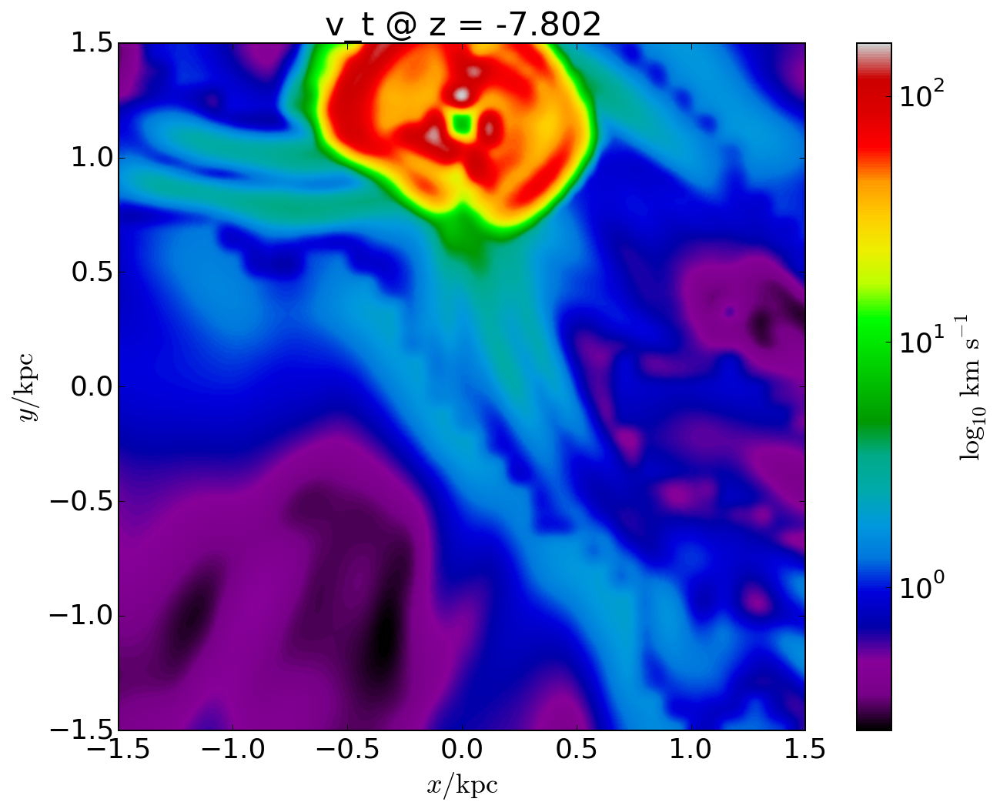

In [38]:
with pynbody.transformation.translate(snBlast,coords2):
    print "Plot v_t..."
    titleStr = "v_t @ z = %.3lf" % z
    sph.image(snBlast.g,qty="tv",width=smallbox,cmap="nipy_spectral", denoise=True ,av_z=False, log=True, 
                  approximate_fast=False,title=titleStr,filename=plotfile+'.vt.old.png'); #vmin=0.006, vmax=1.0,

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.snapshot:Deriving array mass
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


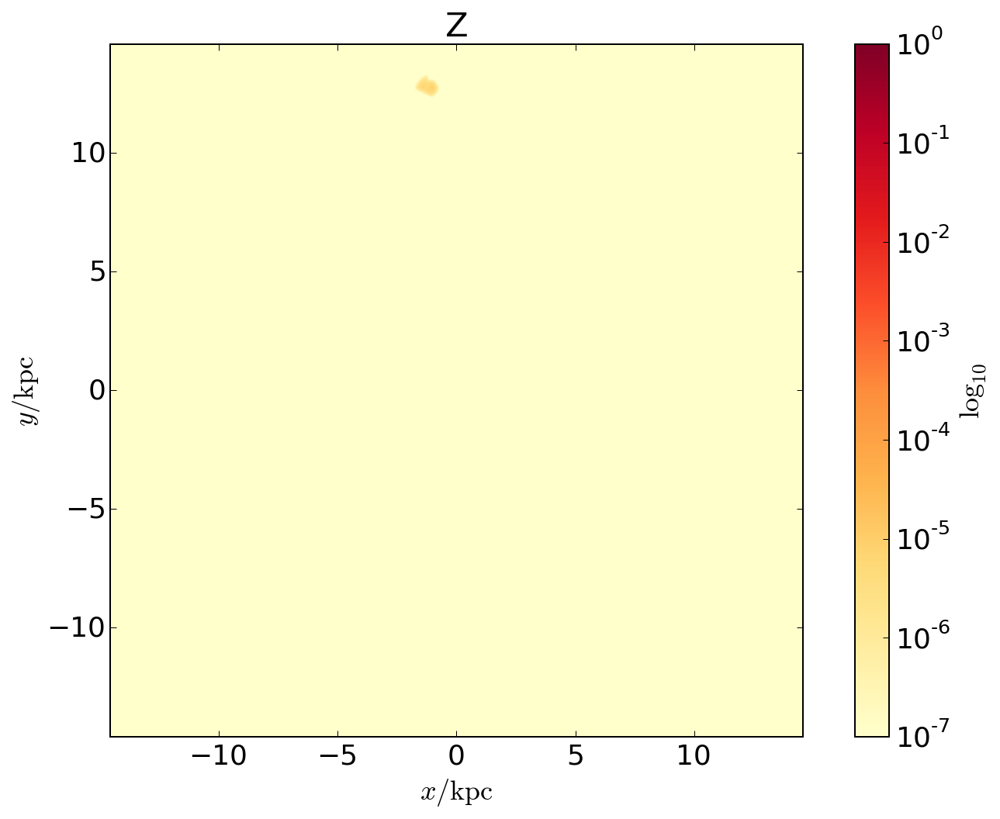

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


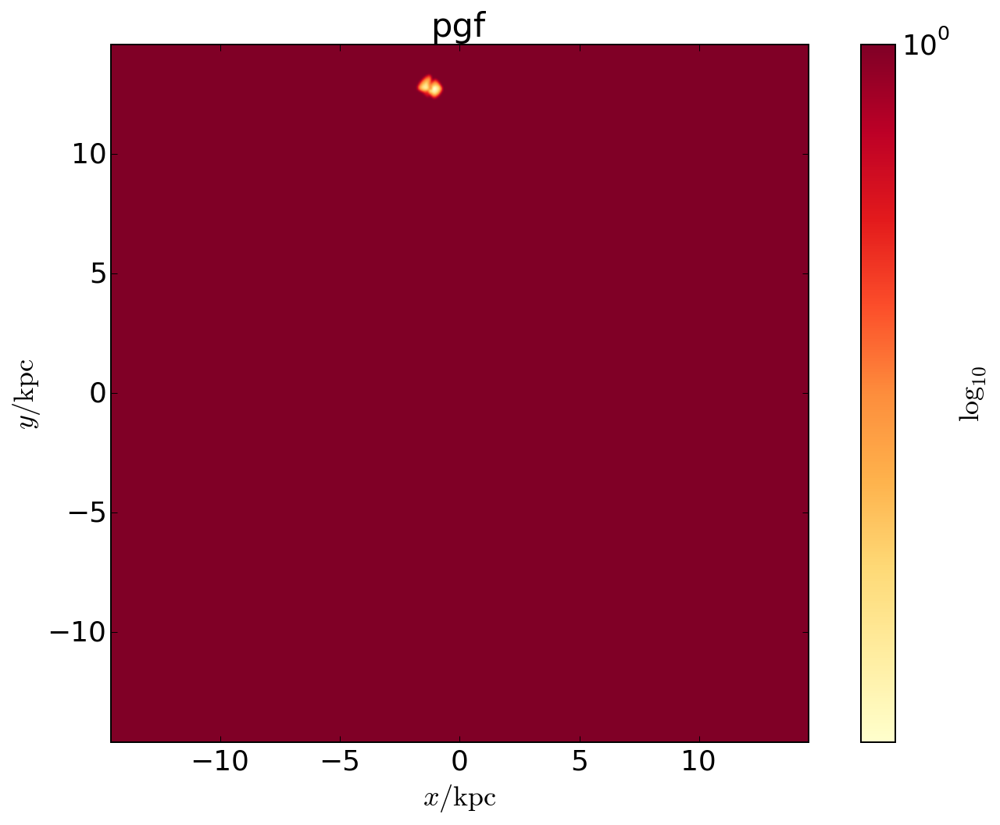

In [10]:
sph.image(s.g,qty="metal",width=boxsizestring,cmap="YlOrRd", denoise=True ,av_z=True, log=True, vmax=1,vmin=1e-7,
              approximate_fast=False,title="Z"); #vmin=0.006, vmax=1.0,
plt.show()
sph.image(s.g,qty="pgf",width=boxsizestring,cmap="YlOrRd", denoise=True ,av_z=True, log=True,
              approximate_fast=False,title="pgf"); #vmin=0.006, vmax=1.0,
plt.show()

In [11]:
s.s['pos']

SimArray([[ -9.39381394,  -5.51457135,  12.96952271],
       [ -1.69480943,  17.09167197,  10.15964148],
       [ -2.19852564,  18.42625401,  12.37384173]], 'kpc')

In [12]:
snBlast = s[pynbody.filt.Cuboid("-6.0 kpc", "10.0 kpc","7.0 kpc",
                                 "4.0 kpc", "18.46 kpc", "16.6 kpc")]

In [13]:
# This is right at the blast ... why only a few points > 20 km/sec!
# Look at pymses output.
snBlast.g['tv'][snBlast.g['tv']>20]

SimArray([ 20.76055802,  20.1067892 ,  21.06231679,  25.30034276,
        20.98863258,  24.8390387 ,  20.17171326,  21.5335847 ], 'km s**-1')

In [14]:
len(snBlast.g['tv'][snBlast.g['tv']>75]),len(snBlast.g)

(0, 478480)

In [15]:
snBlast.g['velMag']=sqrt(snBlast.g['vx']**2+snBlast.g['vy']**2+snBlast.g['vz']**2)

In [16]:
s.g['velMag'].max()

SimArray(26.4883340252488, 'km s**-1')

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


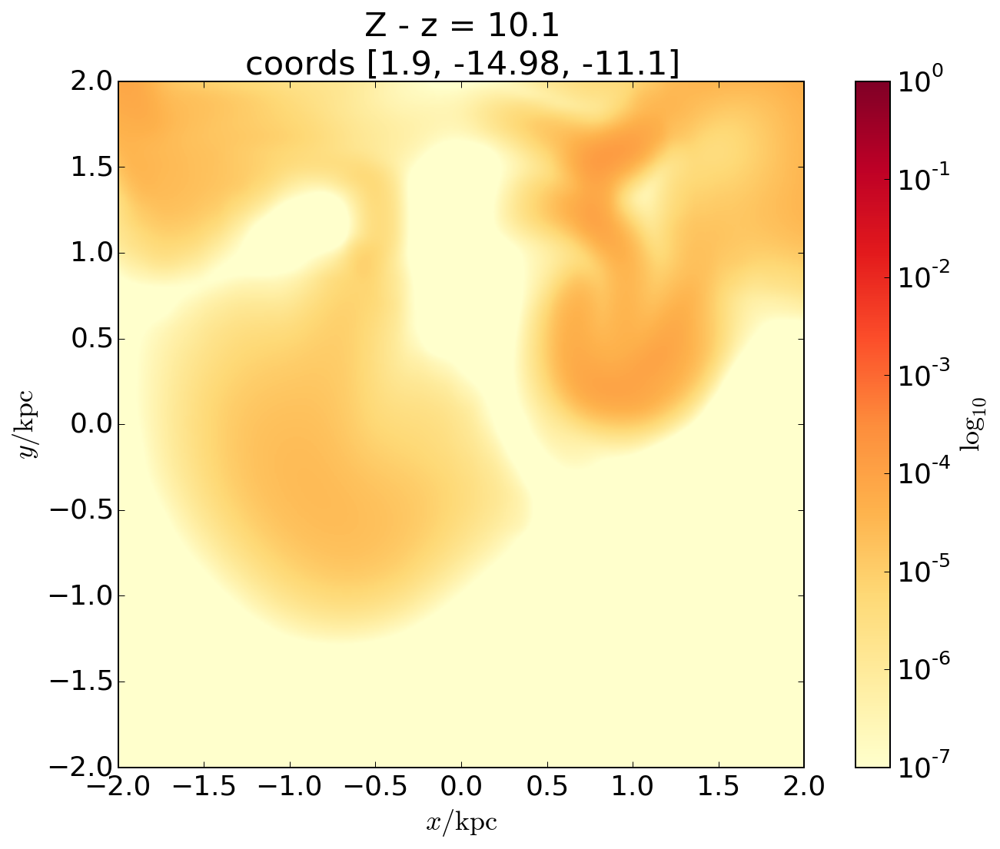

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


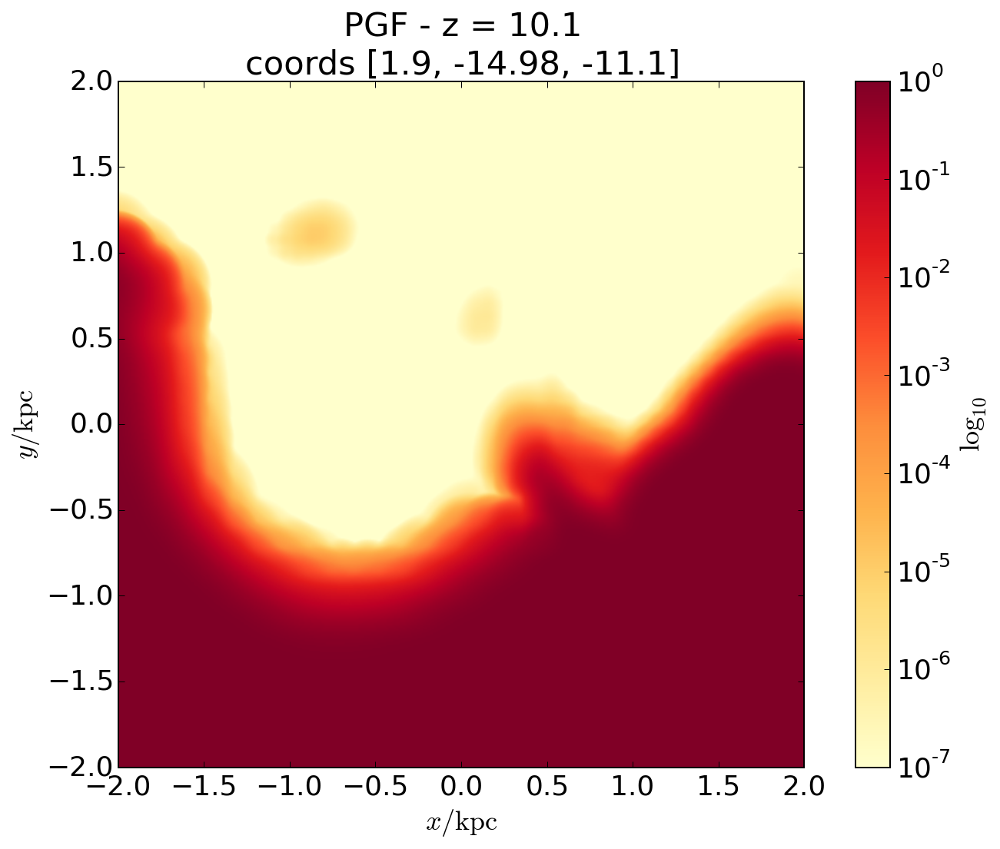

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


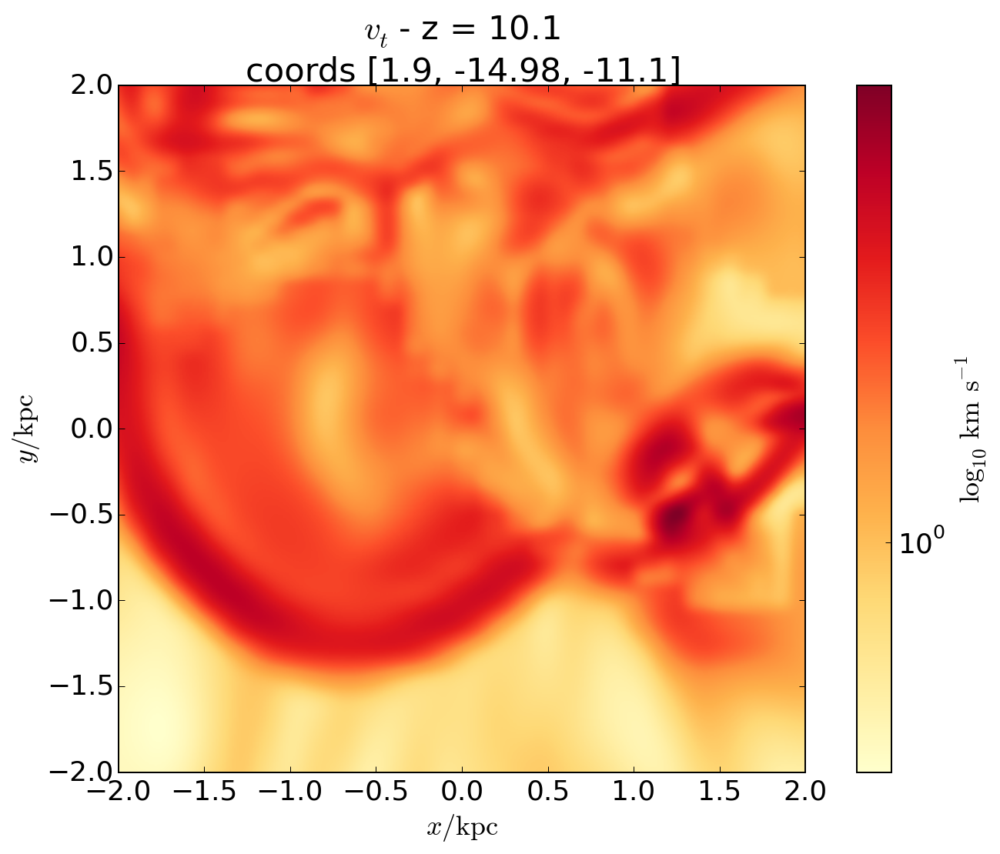

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


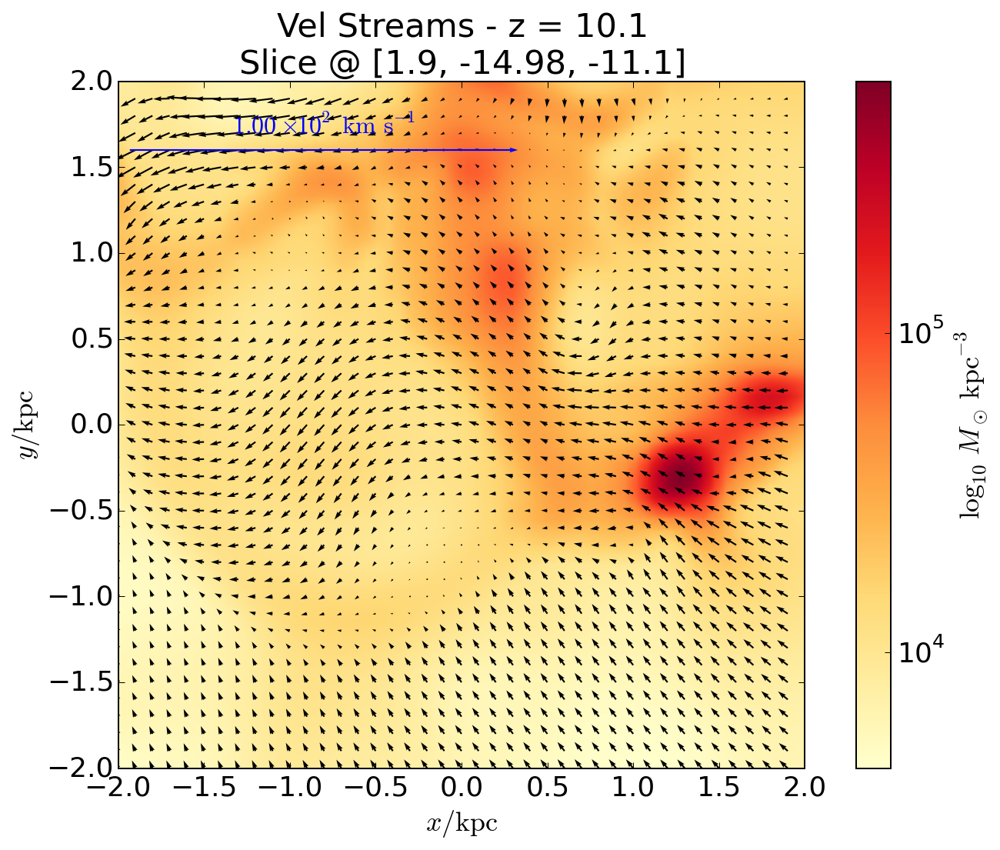

In [17]:
coords2= [1.9,-14.98,-11.1] # NOTE WE ARE TRANSLATING... Note quite center, but the SN is at the edge of the box!
smallbox='4.0 kpc'
with pynbody.transformation.translate(snBlast,coords2):
    titleStr = "Z - z = %.1lf" % z + "\ncoords %s"%str(coords2)
    sph.image(snBlast.g,qty="metal",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=False, log=True, vmax=1,vmin=1e-7,
              approximate_fast=False,title=titleStr,filename="Z - z = %.1lf" % z + " @ %s" % str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()
    titleStr = "PGF - z = %.1lf" % z + "\ncoords %s"%str(coords2)
    sph.image(snBlast.g,qty="pgf",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=False, log=True, vmin=1e-7,
              approximate_fast=False,title=titleStr,filename="PGF - z = %.1lf" % z + " @ %s"%str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()
    titleStr = "$v_{t}$ - z = %.1lf" % z + "\ncoords %s"%str(coords2)
    sph.image(snBlast.g,qty="tv",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=False, log=True, 
              approximate_fast=False,title=titleStr,filename="v_t - z = %.1lf" % z + " @ %s"%str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()
    titleStr = "Vel Streams - z = %.1lf" % z + "\nSlice @ %s" % str(coords2)
    sph.velocity_image(s.g,width=smallbox,cmap="YlOrRd", mode='quiver',key_color='blue',key_length='100 km s**-1',
              vector_resolution=40,title=titleStr,filename="Vel Streams - z = %.1lf" % z + " @ %s" % str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


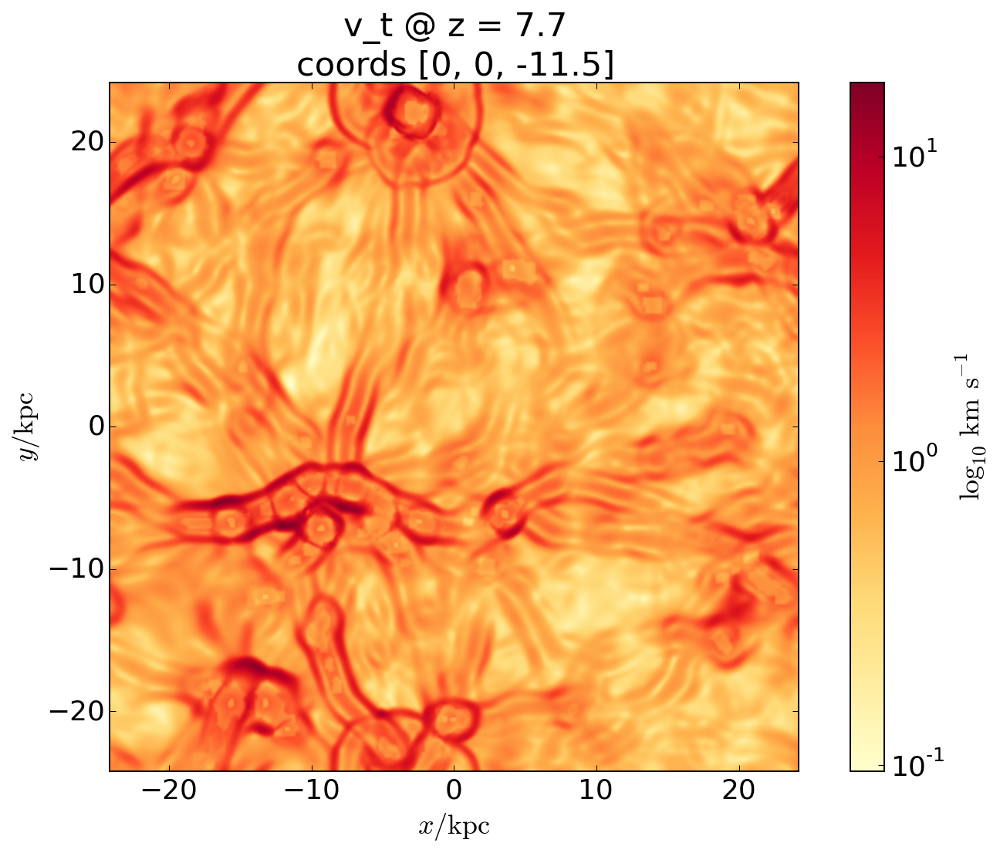

In [24]:
with pynbody.transformation.translate(s,[0,0,-11.5]):
    titleStr = "v_t @ z = %.1lf" % z  + "\ncoords %s"%str([0,0,-11.5])
    sph.image(s.g,qty="tv",width=boxsizestring,cmap="YlOrRd", denoise=True ,av_z=False, log=True, 
                  approximate_fast=False,title=titleStr); #vmin=0.006, vmax=1.0,

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


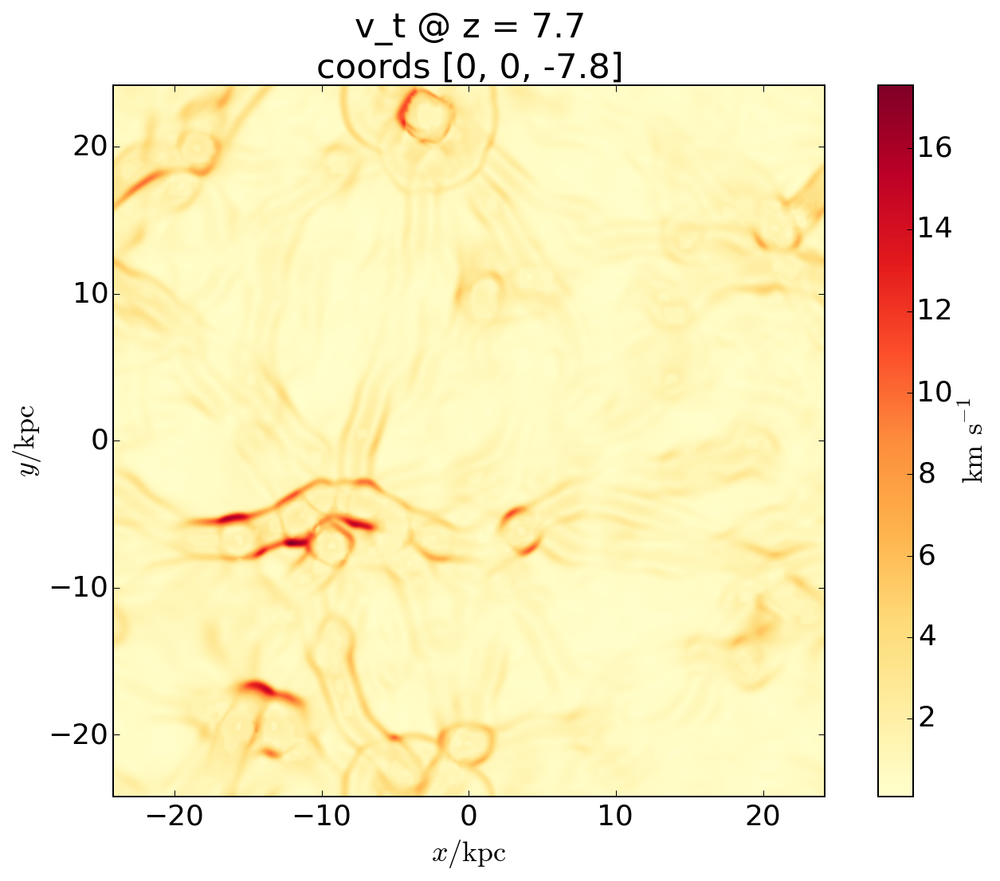

In [25]:
with pynbody.transformation.translate(s,[0,0,-11.5]):
    titleStr = "v_t @ z = %.1lf" % z + "\ncoords %s" % str([0,0,-7.8])
    sph.image(s.g,qty="tv",width=boxsizestring,cmap="YlOrRd", denoise=True ,av_z=False, log=False, 
                  approximate_fast=False,title=titleStr); #vmin=0.006, vmax=1.0,

In [42]:
s.g['mach']=s.g['tv']/s.g['cs']

INFO:pynbody.snapshot:Deriving array cs
INFO:pynbody.snapshot:Deriving array temp
INFO:pynbody.snapshot:Deriving array temp
INFO:pynbody.snapshot:Deriving array u
INFO:pynbody.snapshot:Deriving array mu
INFO:pynbody.snapshot:Converting temp units from k K m_p**-1 to km**2 s**-2
INFO:pynbody.snapshot:Converting temp units from 2.24e+00 K**1/2 k**1/2 m_p**-1/2 to km s**-1


INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


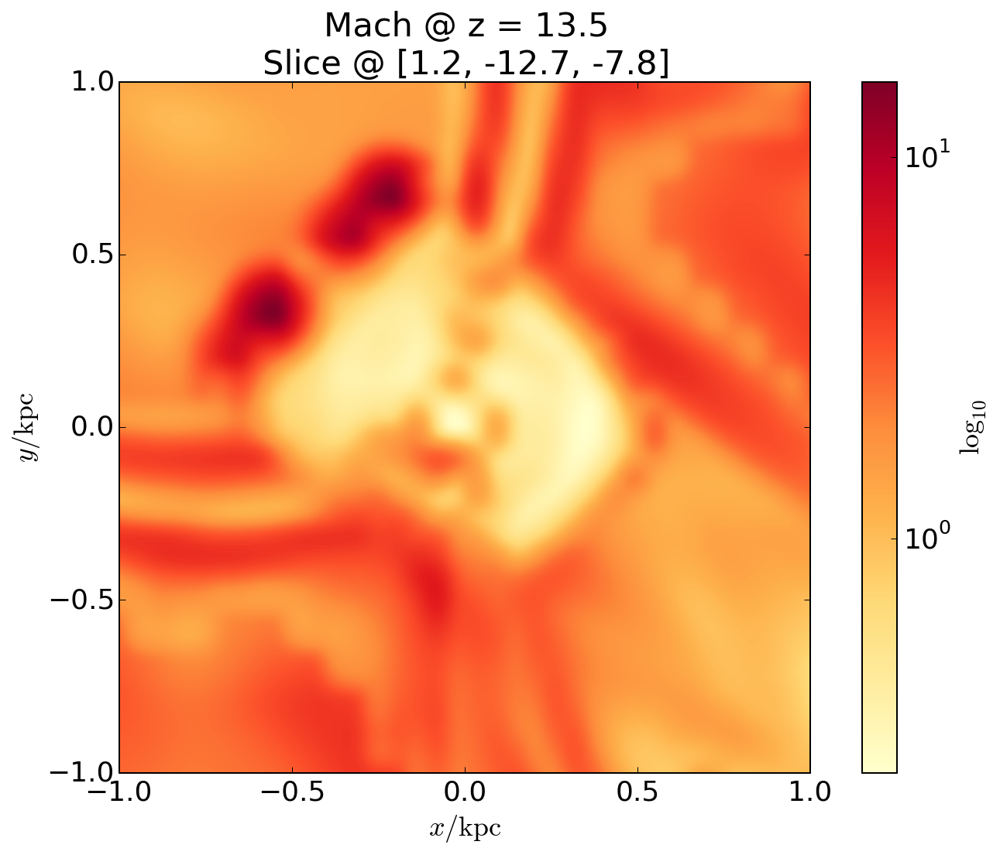

In [43]:
with pynbody.transformation.translate(snBlast,coords):
    titleStr = "Mach @ z = %.1lf" % z + "\nSlice @ %s" % str(coords)
    sph.image(snBlast.g,qty="mach",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=False, log=True, 
              approximate_fast=False,title=titleStr); #vmin=0.006, vmax=1.0,

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


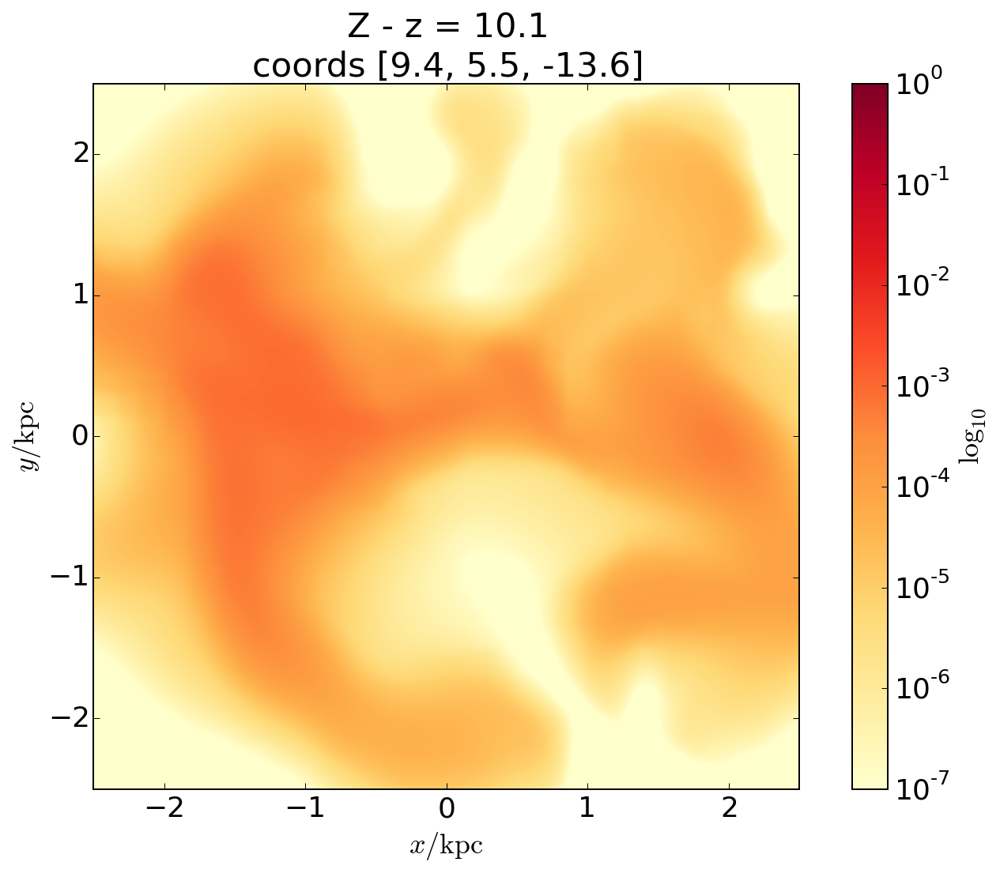

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


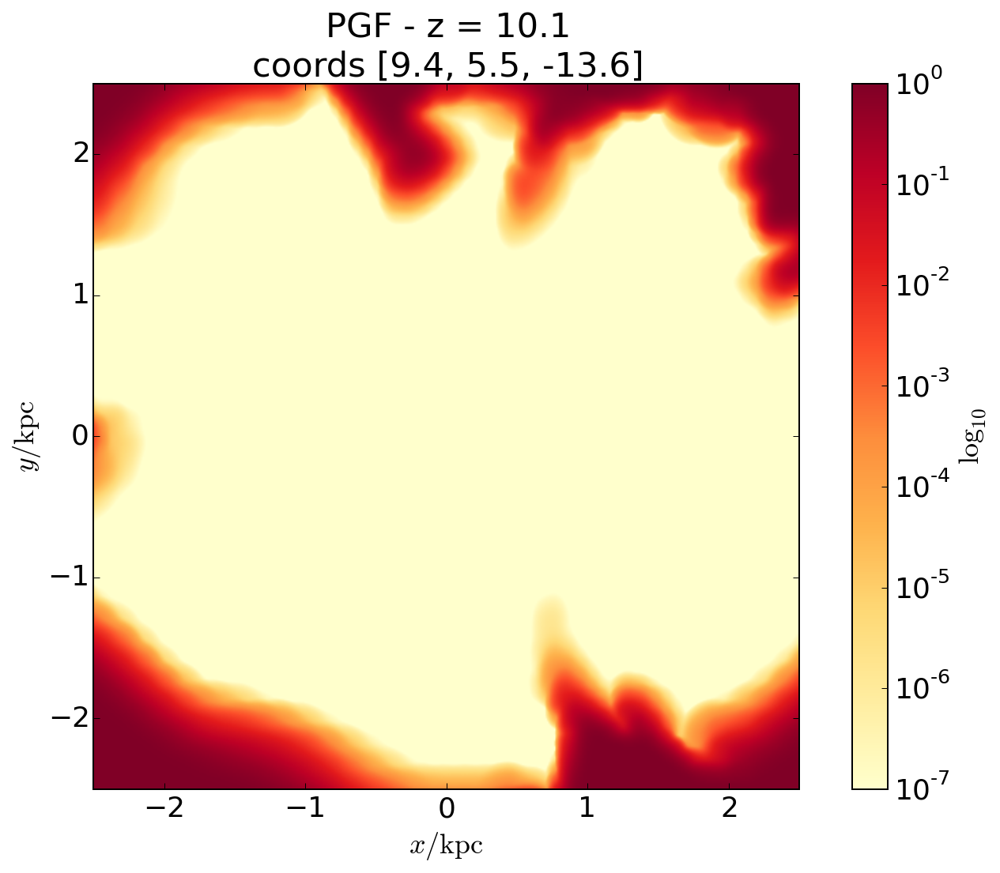

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


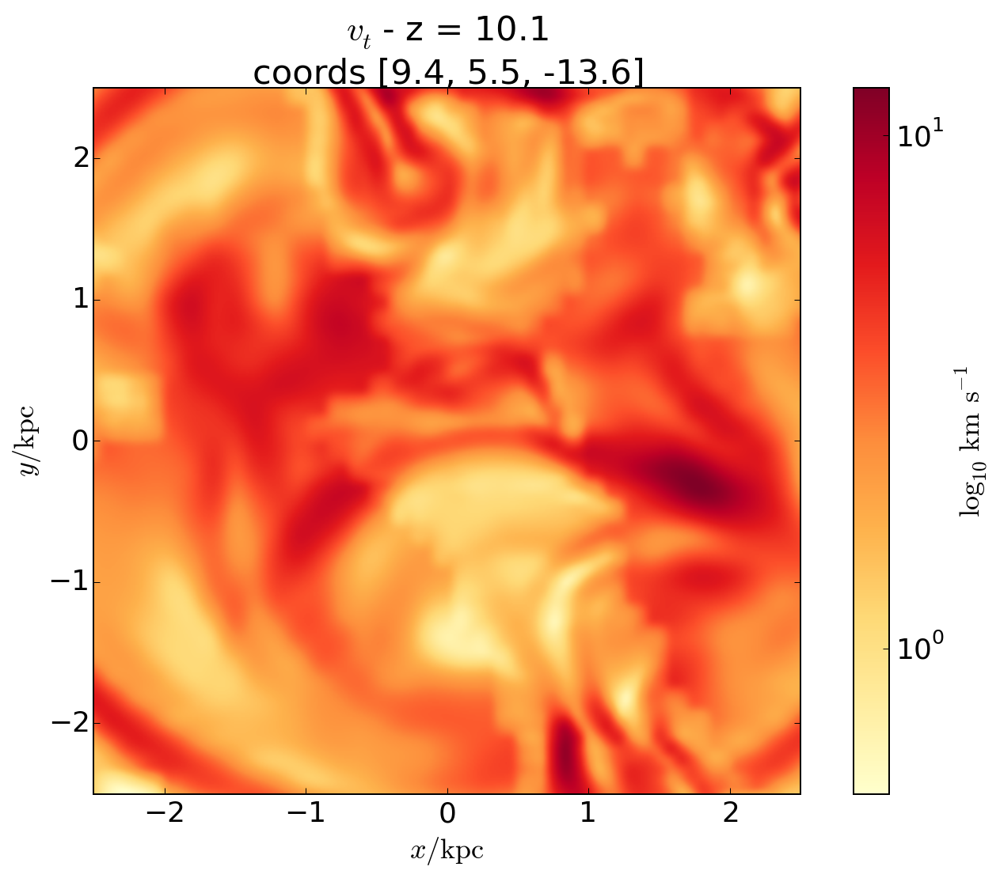

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


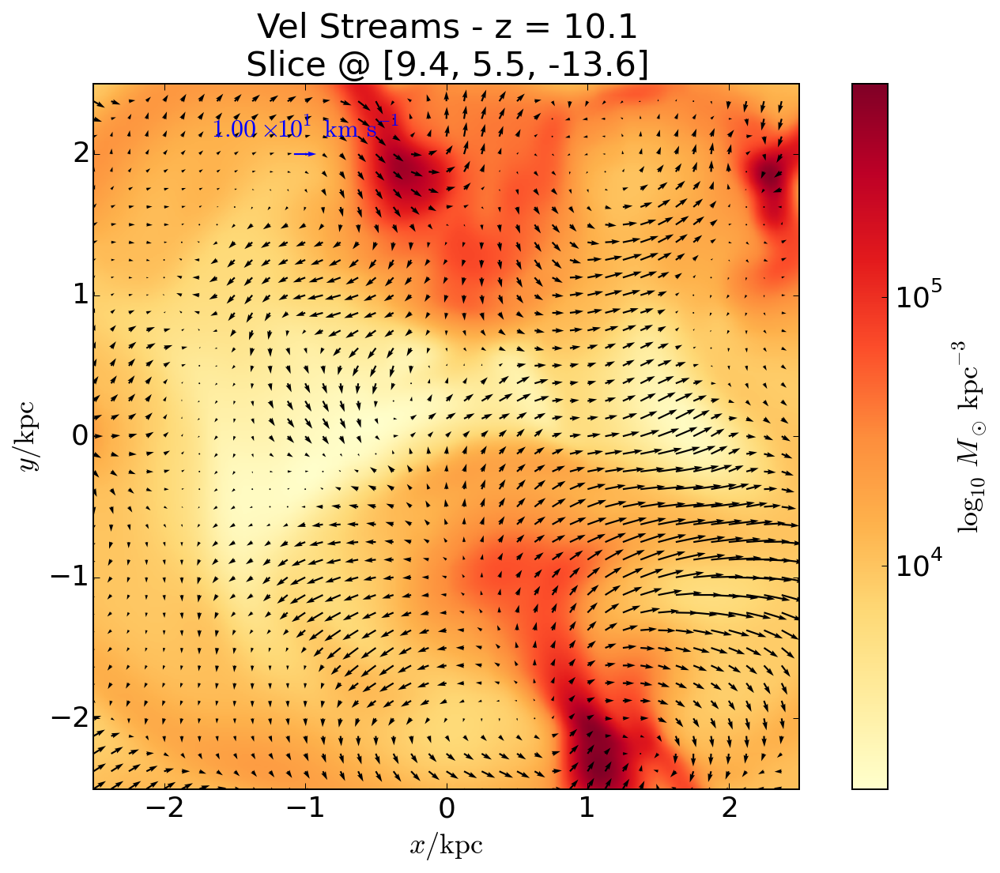

In [50]:
coords2= [9.4, 5.5, -13.6] # NOTE WE ARE TRANSLATING... Note quite center, but the SN is at the edge of the box!
smallbox='5.0 kpc'
with pynbody.transformation.translate(s,coords2):
    titleStr = "Z - z = %.1lf" % z + "\ncoords %s"%str(coords2)
    sph.image(s.g,qty="metal",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=False, log=True, vmax=1,vmin=1e-7,
              approximate_fast=False,title=titleStr,filename="Z - z = %.1lf" % z + " @ %s" % str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()
    titleStr = "PGF - z = %.1lf" % z + "\ncoords %s"%str(coords2)
    sph.image(s.g,qty="pgf",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=False, log=True, vmin=1e-7,
              approximate_fast=False,title=titleStr,filename="PGF - z = %.1lf" % z + " @ %s"%str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()
    titleStr = "$v_{t}$ - z = %.1lf" % z + "\ncoords %s"%str(coords2)
    sph.image(s.g,qty="tv",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=False, log=True, 
              approximate_fast=False,title=titleStr,filename="v_t - z = %.1lf" % z + " @ %s"%str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()
    titleStr = "Vel Streams - z = %.1lf" % z + "\nSlice @ %s" % str(coords2)
    sph.velocity_image(s.g,width=smallbox,cmap="YlOrRd", mode='quiver',key_color='blue',key_length='10 km s**-1',
              vector_resolution=40,title=titleStr,filename="Vel Streams - z = %.1lf" % z + " @ %s" % str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


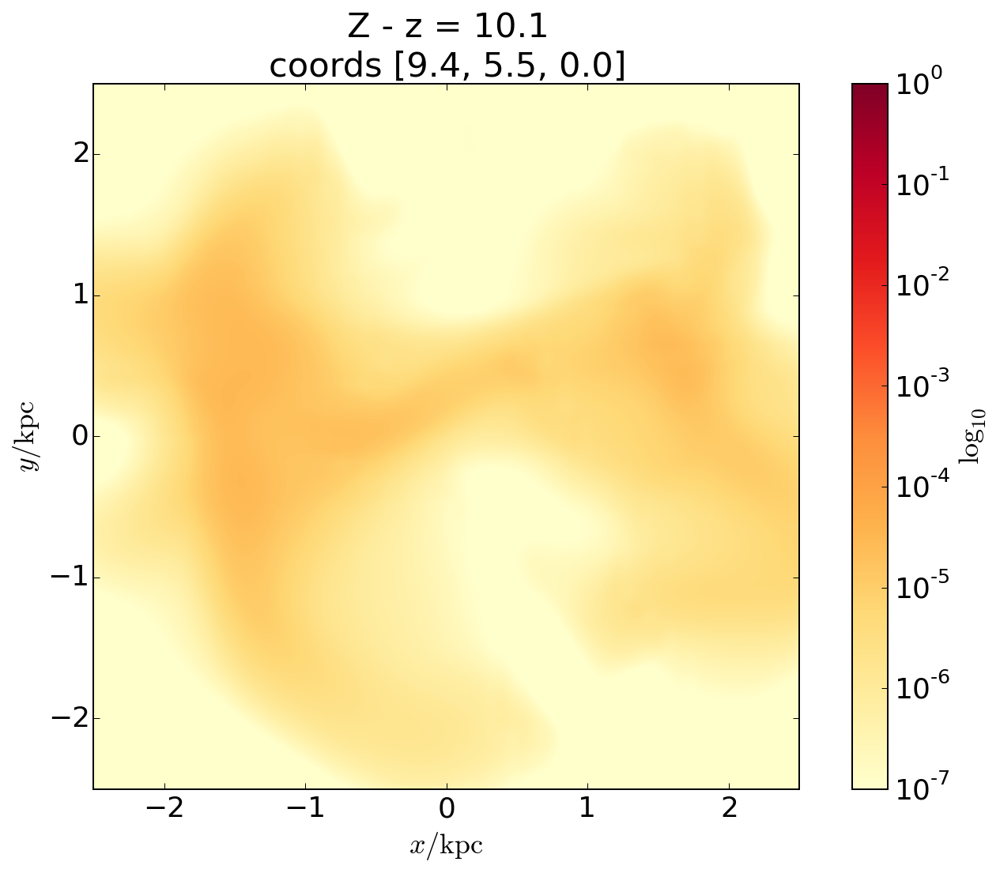

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


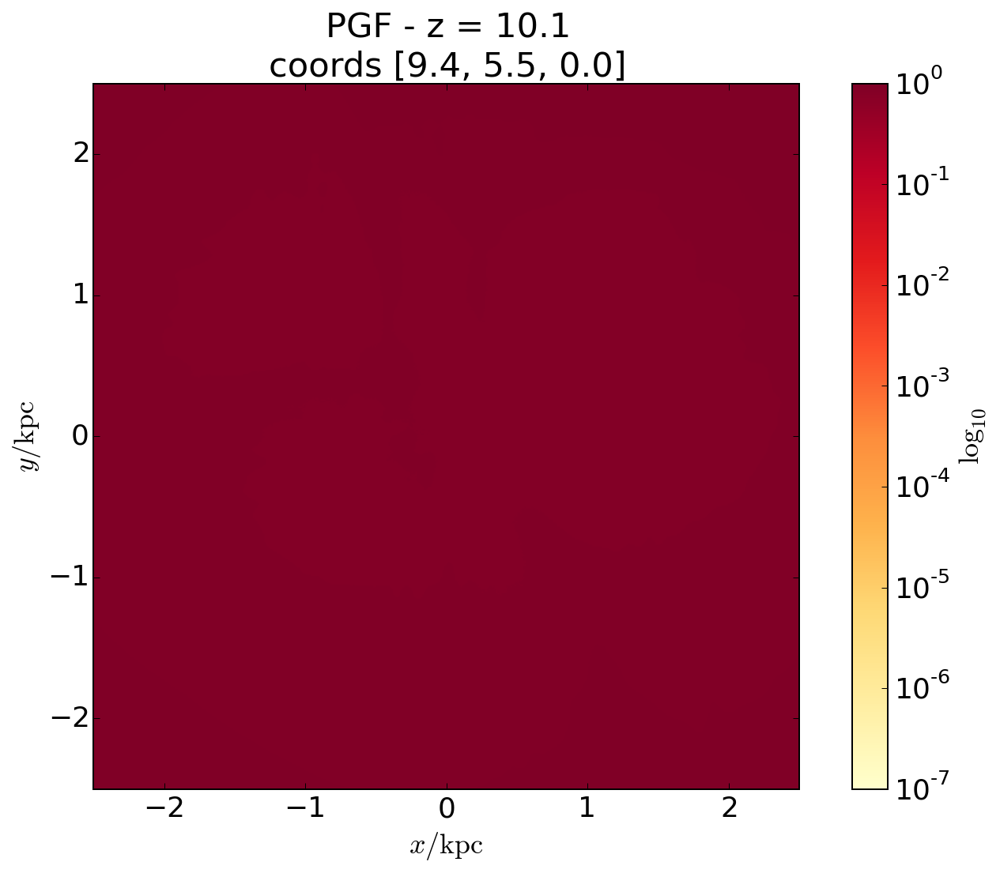

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


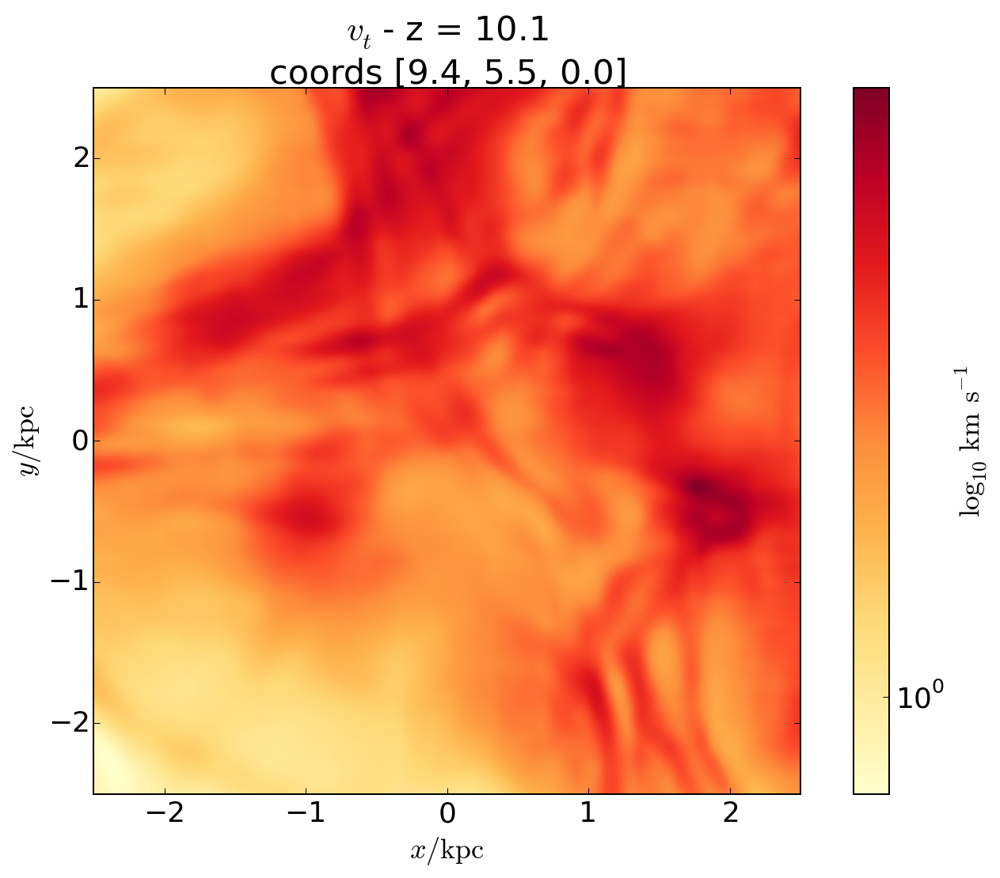

In [46]:
coords2= [9.4, 5.5, 0.0] # NOTE WE ARE TRANSLATING... Note quite center, but the SN is at the edge of the box!
smallbox='5.0 kpc'
with pynbody.transformation.translate(s,coords2):
    titleStr = "Z - z = %.1lf" % z + "\ncoords %s"%str(coords2)
    sph.image(s.g,qty="metal",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=True, log=True, vmax=1,vmin=1e-7,
              approximate_fast=False,title=titleStr,filename="Z - z = %.1lf" % z + " @ %s" % str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()
    titleStr = "PGF - z = %.1lf" % z + "\ncoords %s"%str(coords2)
    sph.image(s.g,qty="pgf",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=True, log=True, vmin=1e-7,
              approximate_fast=False,title=titleStr,filename="PGF - z = %.1lf" % z + " @ %s"%str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()
    titleStr = "$v_{t}$ - z = %.1lf" % z + "\ncoords %s"%str(coords2)
    sph.image(s.g,qty="tv",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=True, log=True, 
              approximate_fast=False,title=titleStr,filename="v_t - z = %.1lf" % z + " @ %s"%str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()

In [49]:
titleStr = "Z - z = %.1lf" % z + "\ncoords %s"%str(coords2)
sph.image(s.g,qty="metal",width=boxsizestring,cmap="YlOrRd", denoise=True ,av_z=False, log=True, vmin=1e-7,
              approximate_fast=False,title=titleStr); #vmin=0.006, vmax=1.0,




INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


ValueError: Failed to make a sensible logarithmic image. This probably means there are no particles in the view.

In [45]:
snBlast.g['mach'].max()

SimArray(32.98736064250052, '1.00e+00')

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


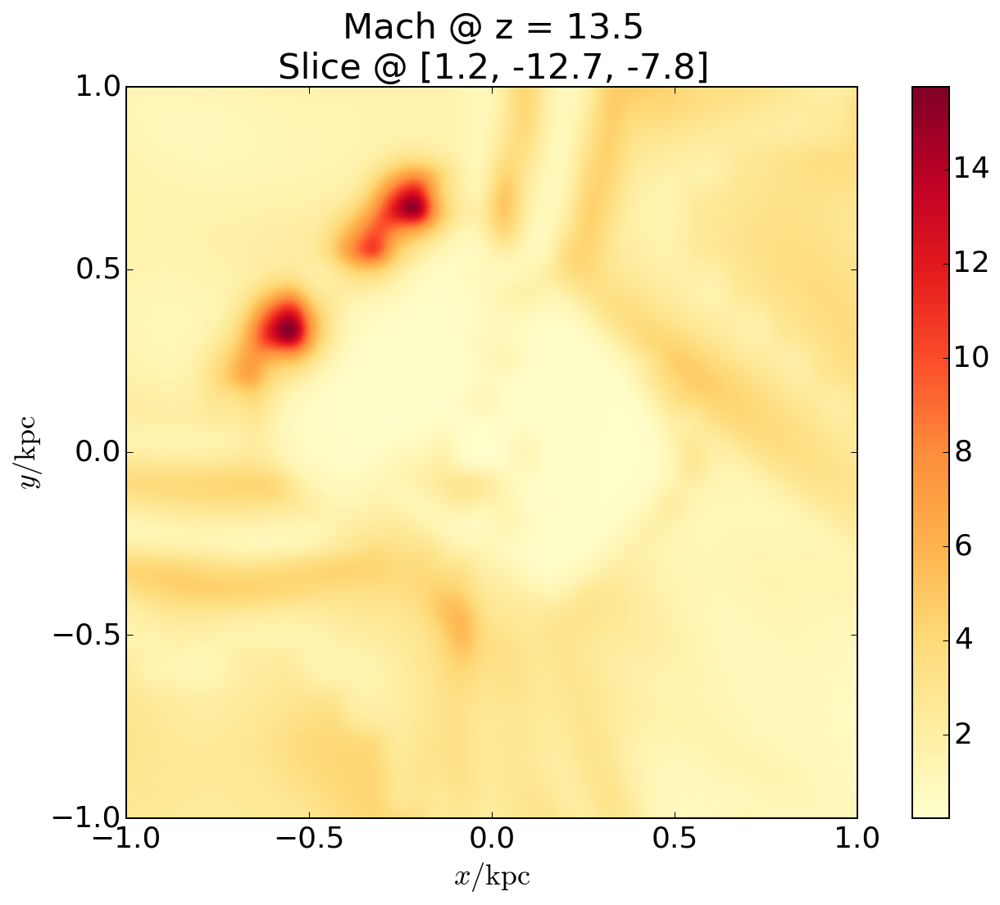

In [44]:
with pynbody.transformation.translate(snBlast,coords):
    titleStr = "Mach @ z = %.1lf" % z + "\nSlice @ %s" % str(coords)
    sph.image(snBlast.g,qty="mach",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=False, log=False, 
              approximate_fast=False,title=titleStr); #vmin=0.006, vmax=1.0,

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


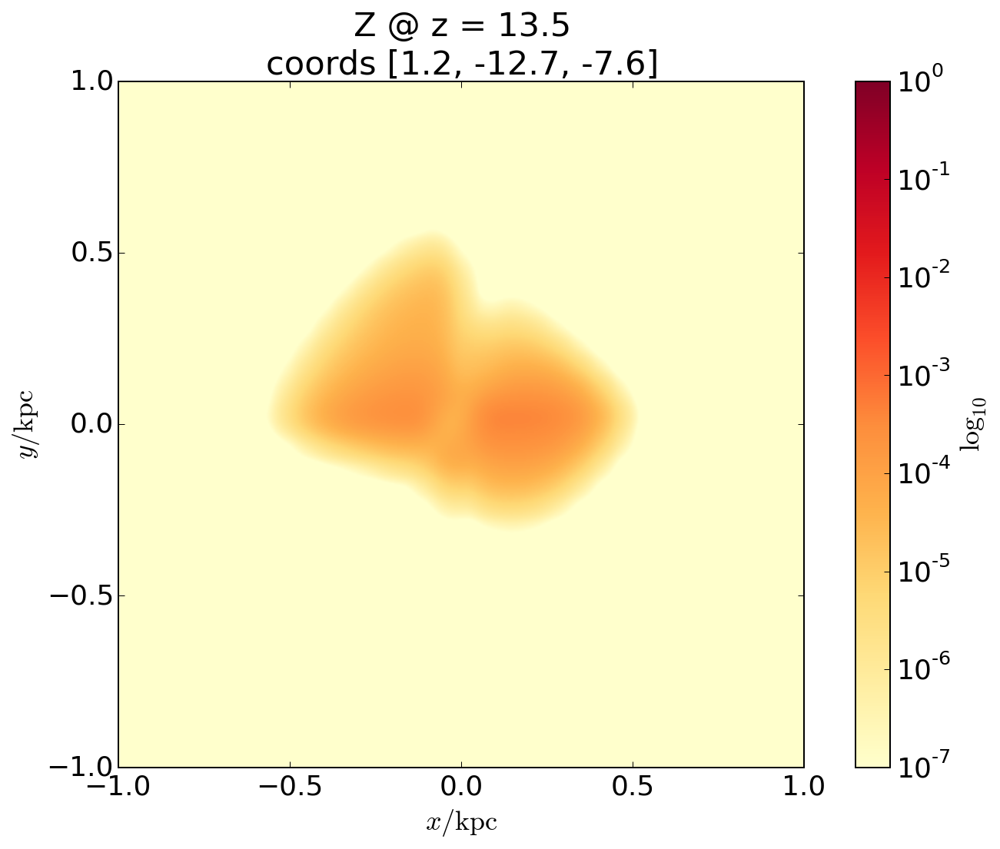

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


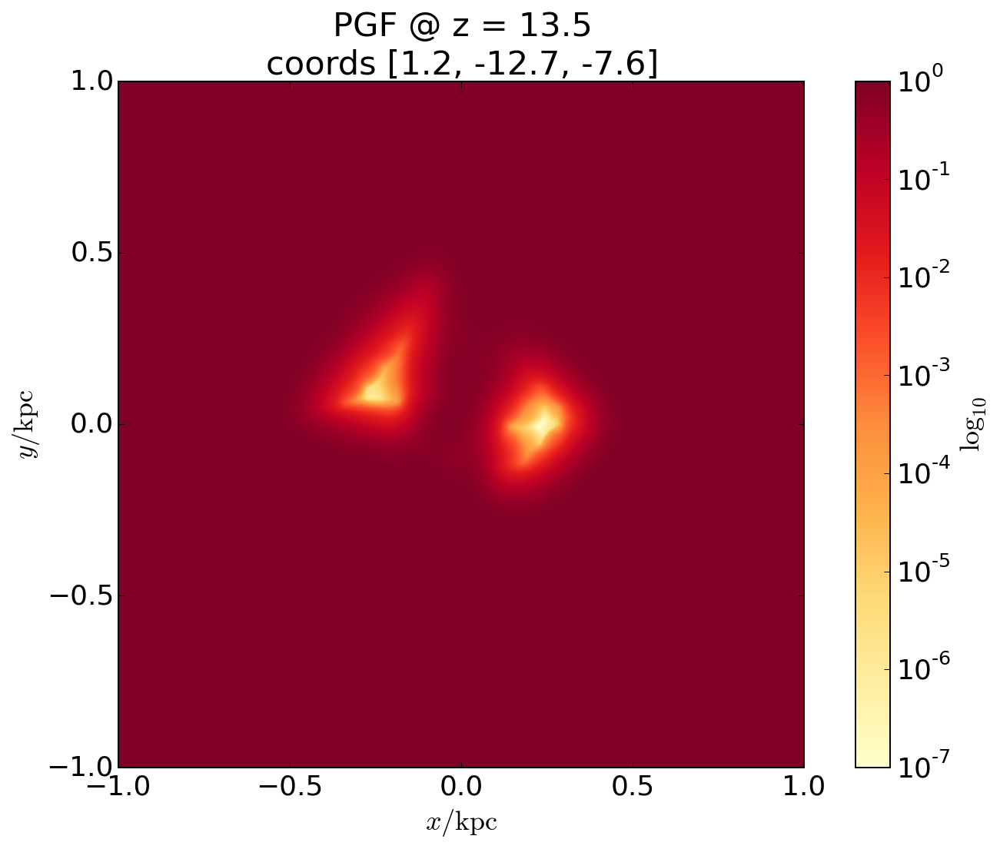

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


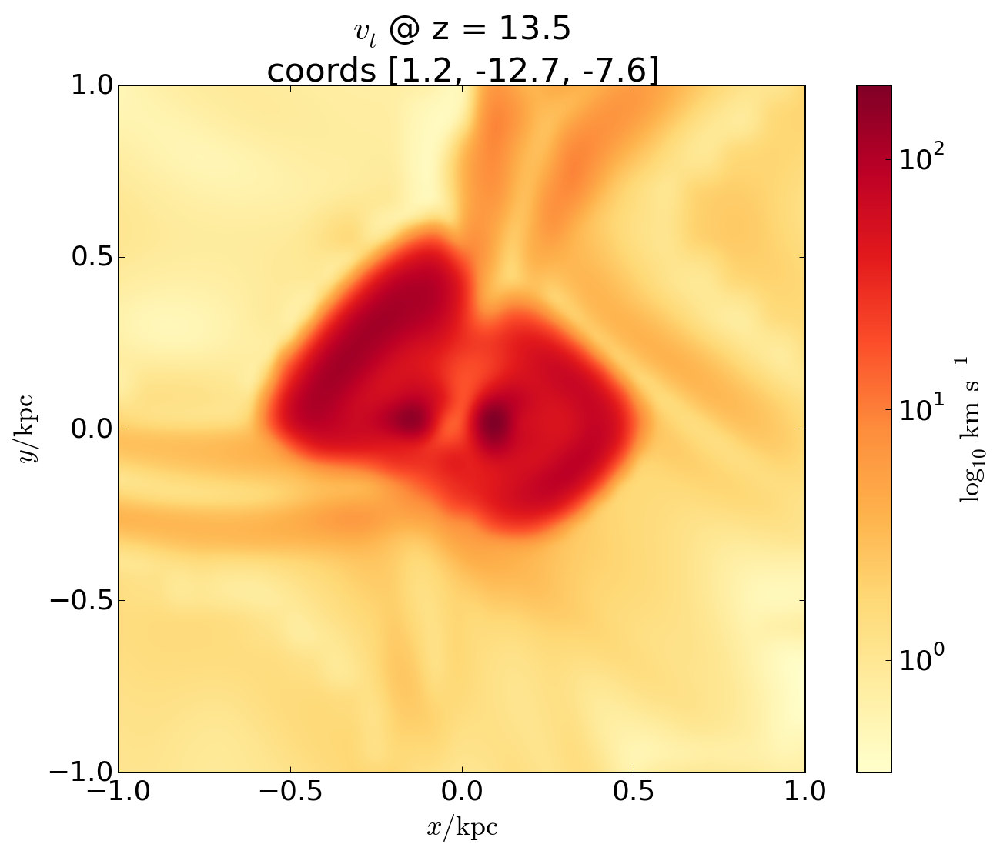

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


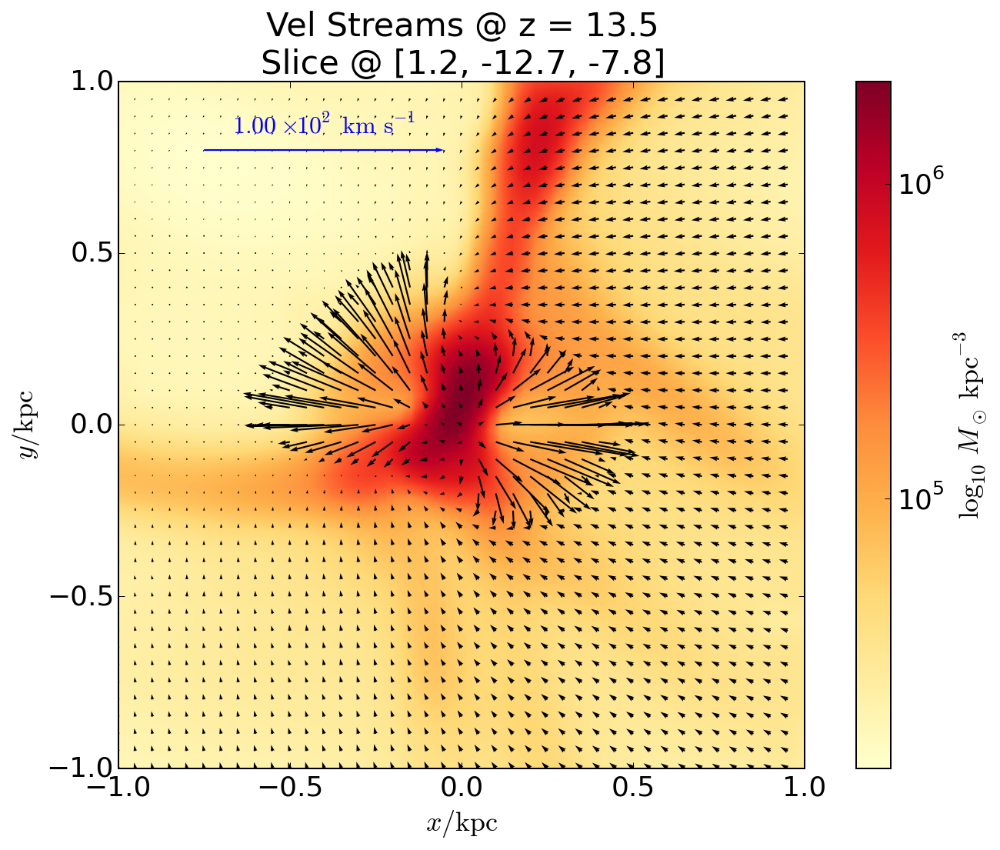

In [54]:
coords2= [1.2,-12.7,-7.6] # NOTE WE ARE TRANSLATING... HENCE THE - SIGN...
smallbox='2 kpc'
with pynbody.transformation.translate(snBlast,coords2):
    titleStr = "Z @ z = %.1lf" % z + "\ncoords %s"%str(coords2)
    sph.image(snBlast.g,qty="metal",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=False, log=True, vmax=1,vmin=1e-7,
              approximate_fast=False,title=titleStr,filename="Z @ z = %.1lf" % z + " @ %s" % str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()
    titleStr = "PGF @ z = %.1lf" % z + "\ncoords %s"%str(coords2)
    sph.image(snBlast.g,qty="pgf",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=False, log=True, vmin=1e-7,
              approximate_fast=False,title=titleStr,filename="PGF @ z = %.1lf" % z + " @ %s"%str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()
    titleStr = "$v_{t}$ @ z = %.1lf" % z + "\ncoords %s"%str(coords2)
    sph.image(snBlast.g,qty="tv",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=False, log=True, 
              approximate_fast=False,title=titleStr,filename="v_t @ z = %.1lf" % z + " @ %s"%str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()
    titleStr = "Vel Streams @ z = %.1lf" % z + "\nSlice @ %s" % str(coords)
    sph.velocity_image(s.g,width=smallbox,cmap="YlOrRd", mode='quiver',key_color='blue',key_length='100 km s**-1',
              vector_resolution=40,title=titleStr,filename="Vel Streams @ z = %.1lf" % z + " @ %s" % str(coords)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


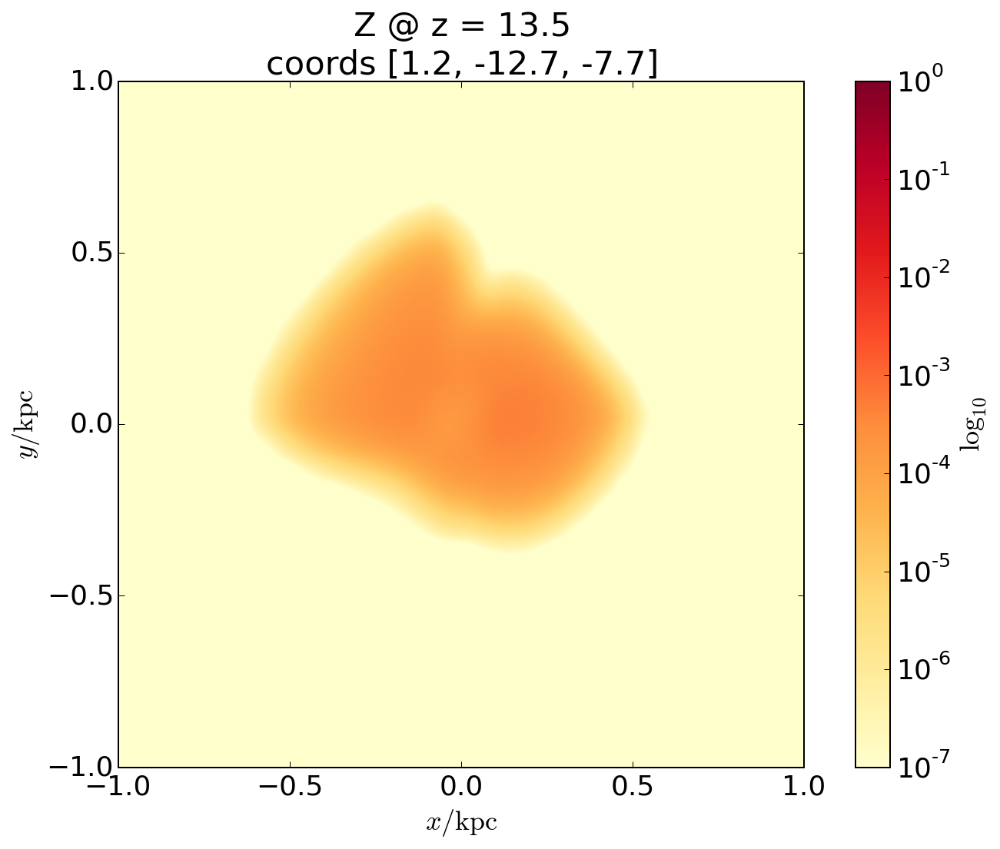

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


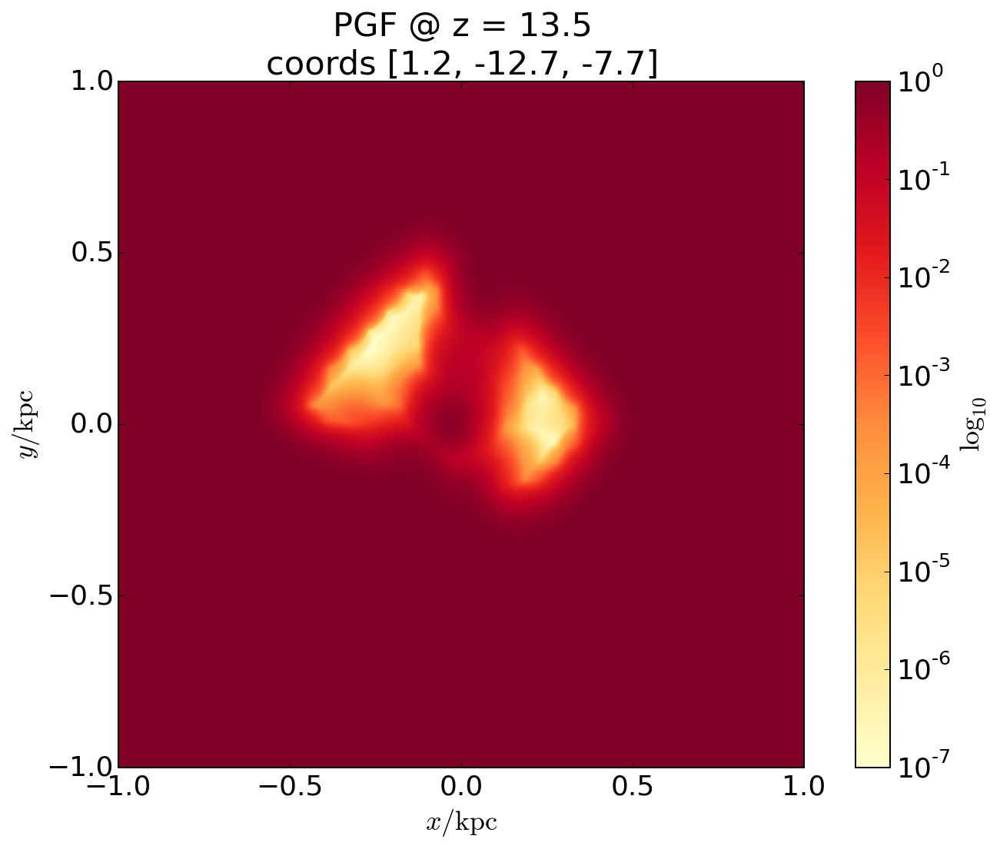

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


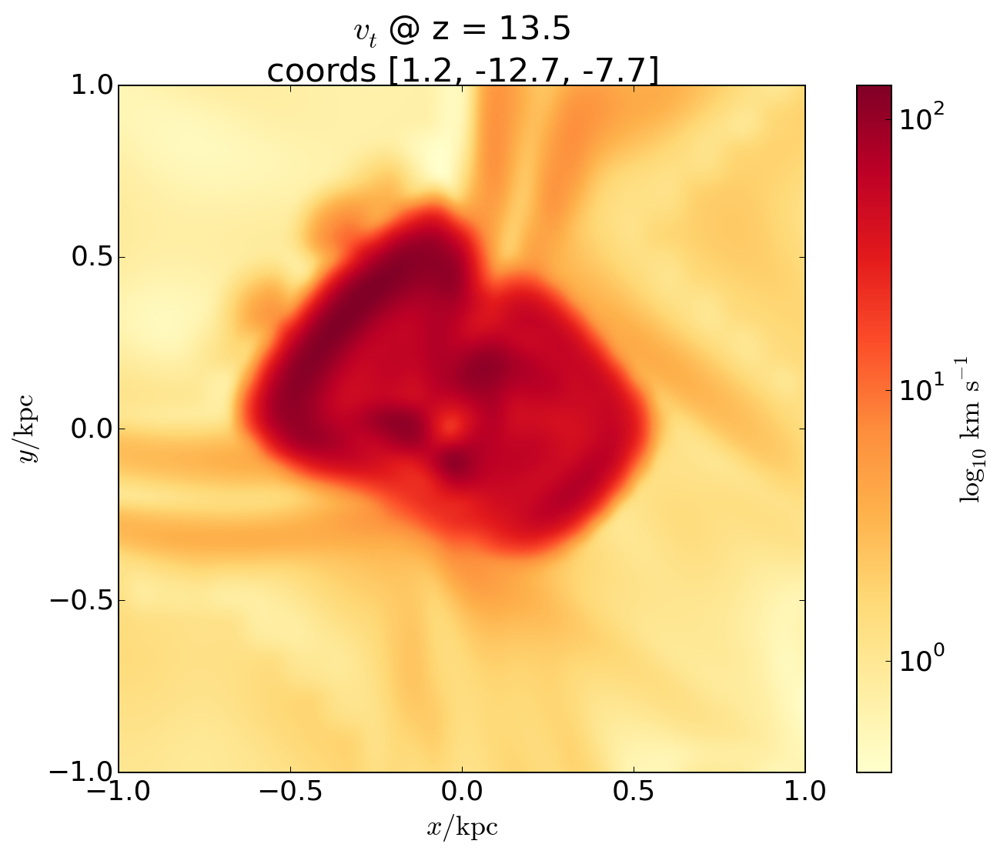

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


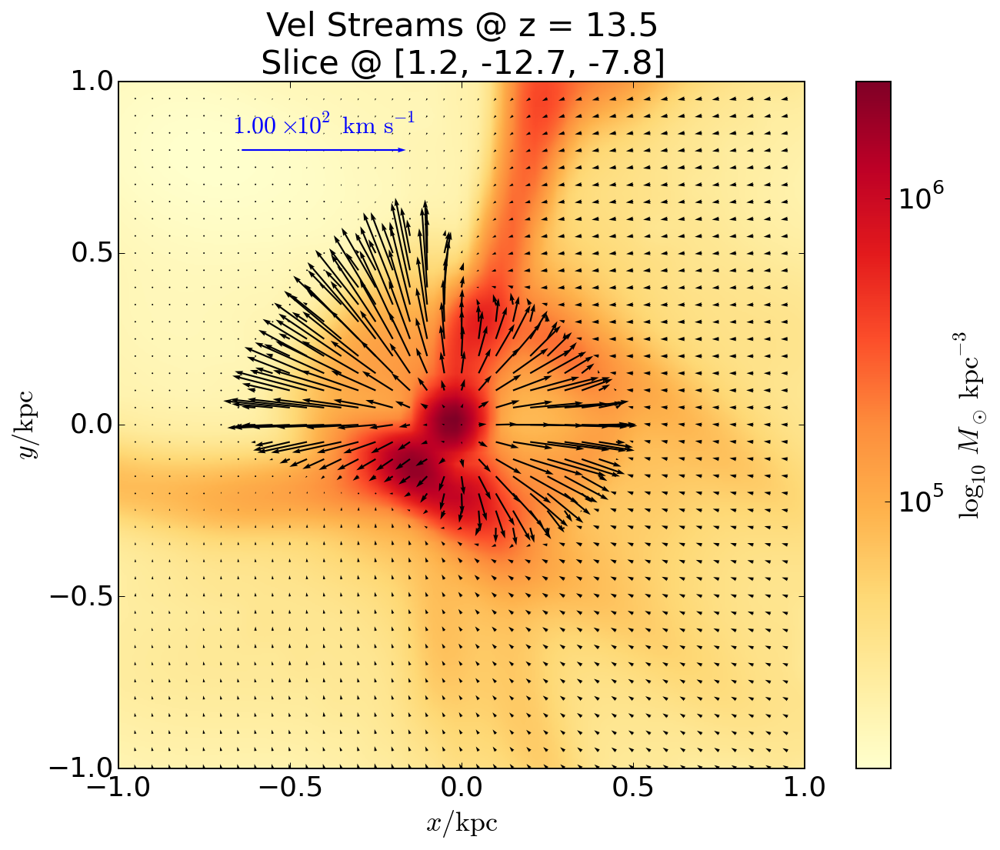

In [55]:
coords2= [1.2,-12.7,-7.7] # NOTE WE ARE TRANSLATING... HENCE THE - SIGN...
smallbox='2 kpc'
with pynbody.transformation.translate(snBlast,coords2):
    titleStr = "Z @ z = %.1lf" % z + "\ncoords %s"%str(coords2)
    sph.image(snBlast.g,qty="metal",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=False, log=True, vmax=1,vmin=1e-7,
              approximate_fast=False,title=titleStr,filename="Z @ z = %.1lf" % z + " @ %s" % str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()
    titleStr = "PGF @ z = %.1lf" % z + "\ncoords %s"%str(coords2)
    sph.image(snBlast.g,qty="pgf",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=False, log=True, vmin=1e-7,
              approximate_fast=False,title=titleStr,filename="PGF @ z = %.1lf" % z + " @ %s"%str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()
    titleStr = "$v_{t}$ @ z = %.1lf" % z + "\ncoords %s"%str(coords2)
    sph.image(snBlast.g,qty="tv",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=False, log=True, 
              approximate_fast=False,title=titleStr,filename="v_t @ z = %.1lf" % z + " @ %s"%str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()
    titleStr = "Vel Streams @ z = %.1lf" % z + "\nSlice @ %s" % str(coords)
    sph.velocity_image(s.g,width=smallbox,cmap="YlOrRd", mode='quiver',key_color='blue',key_length='100 km s**-1',
              vector_resolution=40,title=titleStr,filename="Vel Streams @ z = %.1lf" % z + " @ %s" % str(coords)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


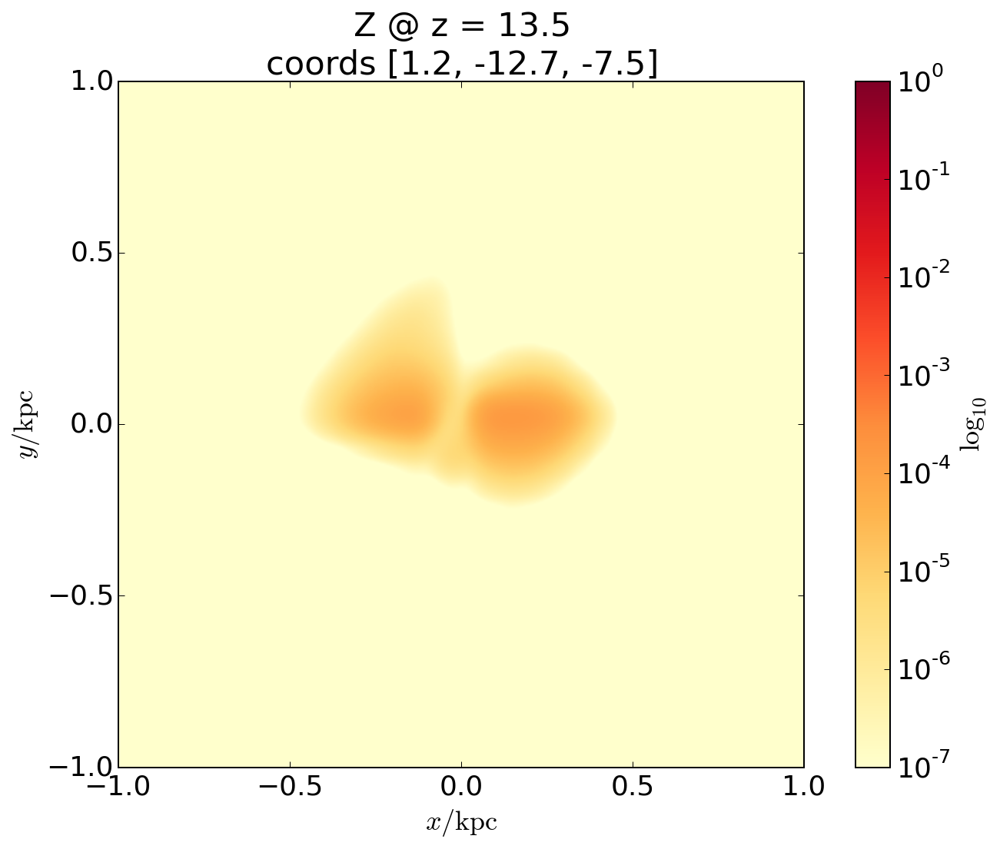

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


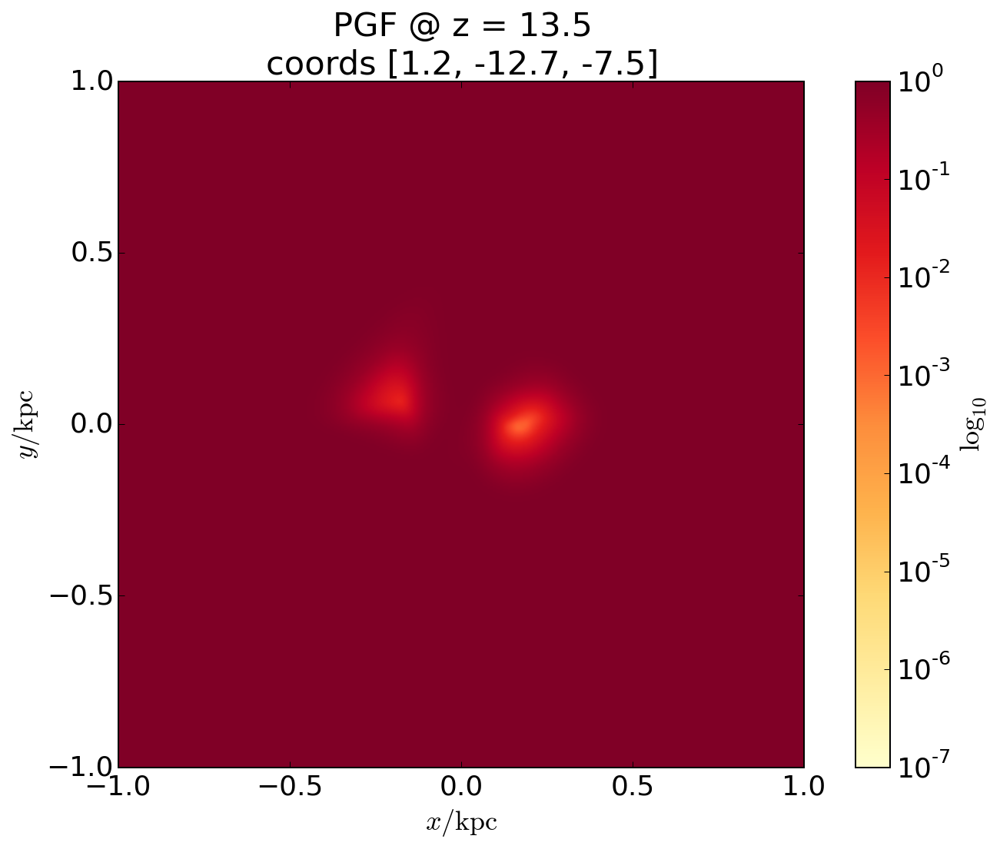

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


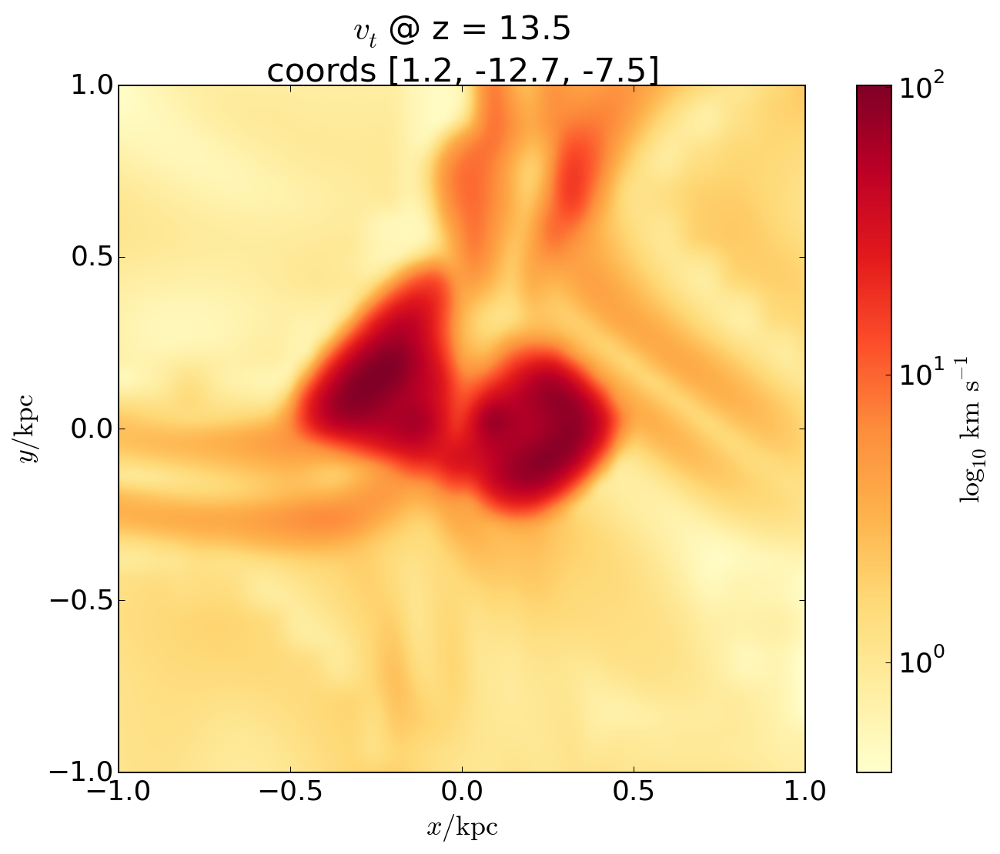

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


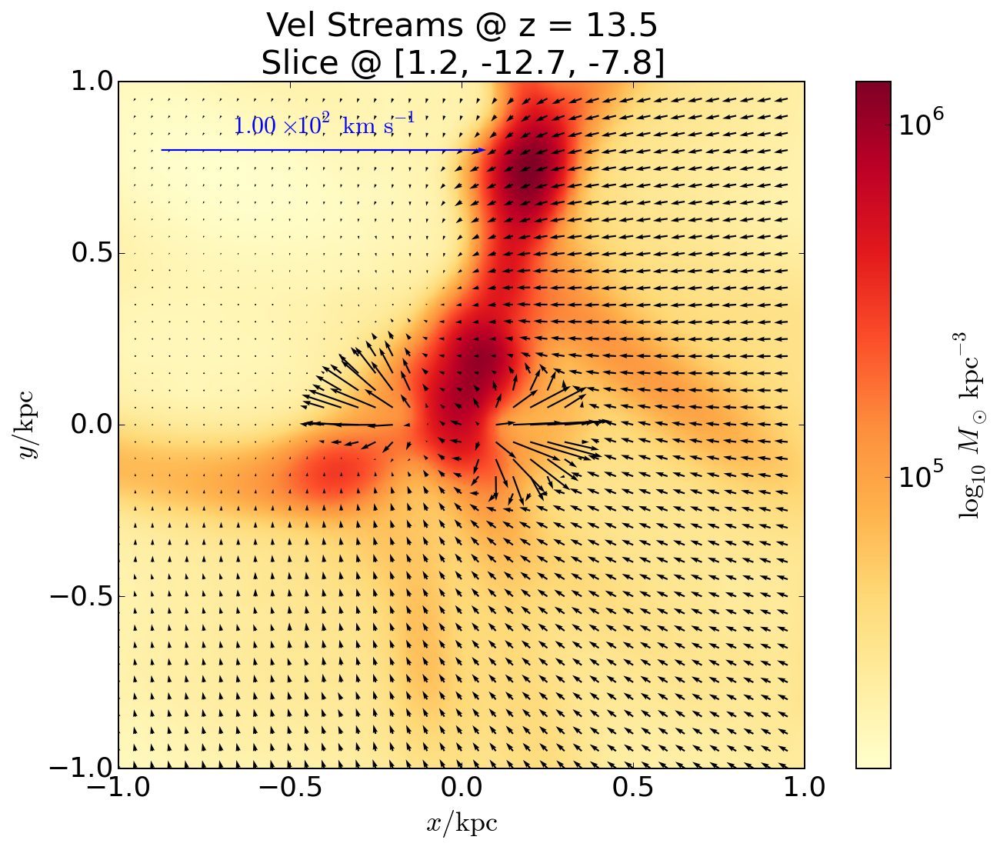

In [56]:
coords2= [1.2,-12.7,-7.5] # NOTE WE ARE TRANSLATING... HENCE THE - SIGN...
smallbox='2 kpc'
with pynbody.transformation.translate(snBlast,coords2):
    titleStr = "Z @ z = %.1lf" % z + "\ncoords %s"%str(coords2)
    sph.image(snBlast.g,qty="metal",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=False, log=True, vmax=1,vmin=1e-7,
              approximate_fast=False,title=titleStr,filename="Z @ z = %.1lf" % z + " @ %s" % str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()
    titleStr = "PGF @ z = %.1lf" % z + "\ncoords %s"%str(coords2)
    sph.image(snBlast.g,qty="pgf",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=False, log=True, vmin=1e-7,
              approximate_fast=False,title=titleStr,filename="PGF @ z = %.1lf" % z + " @ %s"%str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()
    titleStr = "$v_{t}$ @ z = %.1lf" % z + "\ncoords %s"%str(coords2)
    sph.image(snBlast.g,qty="tv",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=False, log=True, 
              approximate_fast=False,title=titleStr,filename="v_t @ z = %.1lf" % z + " @ %s"%str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()
    titleStr = "Vel Streams @ z = %.1lf" % z + "\nSlice @ %s" % str(coords)
    sph.velocity_image(s.g,width=smallbox,cmap="YlOrRd", mode='quiver',key_color='blue',key_length='100 km s**-1',
              vector_resolution=40,title=titleStr,filename="Vel Streams @ z = %.1lf" % z + " @ %s" % str(coords)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


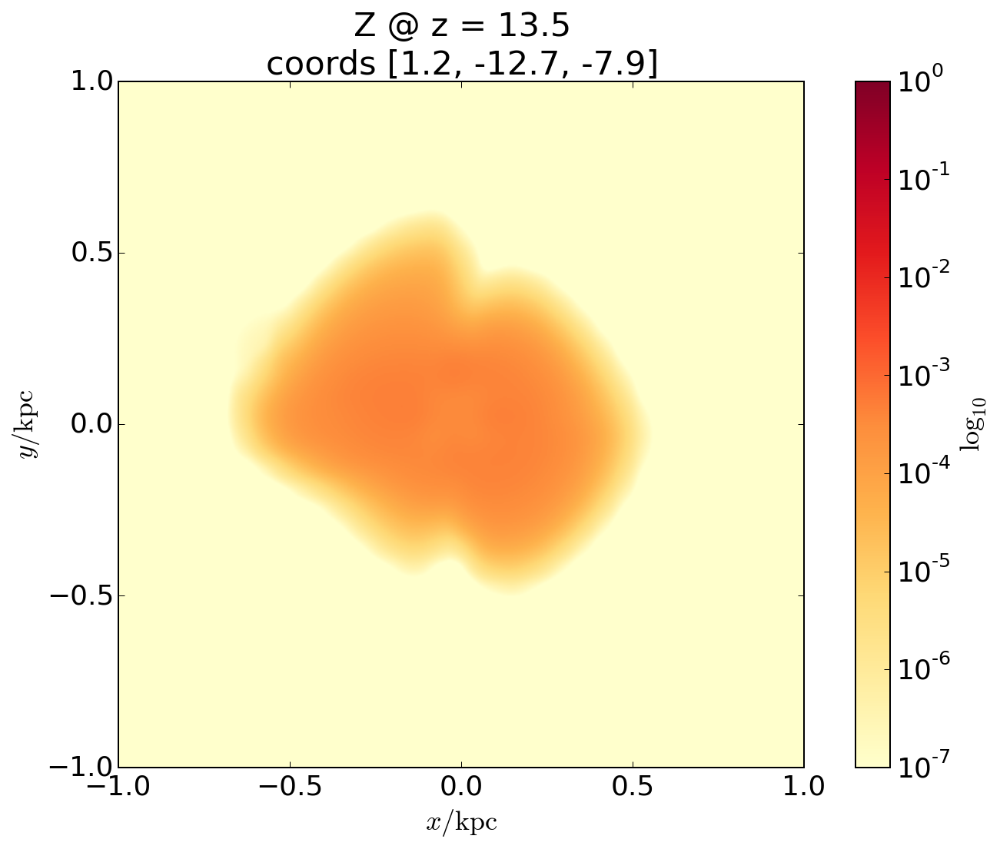

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


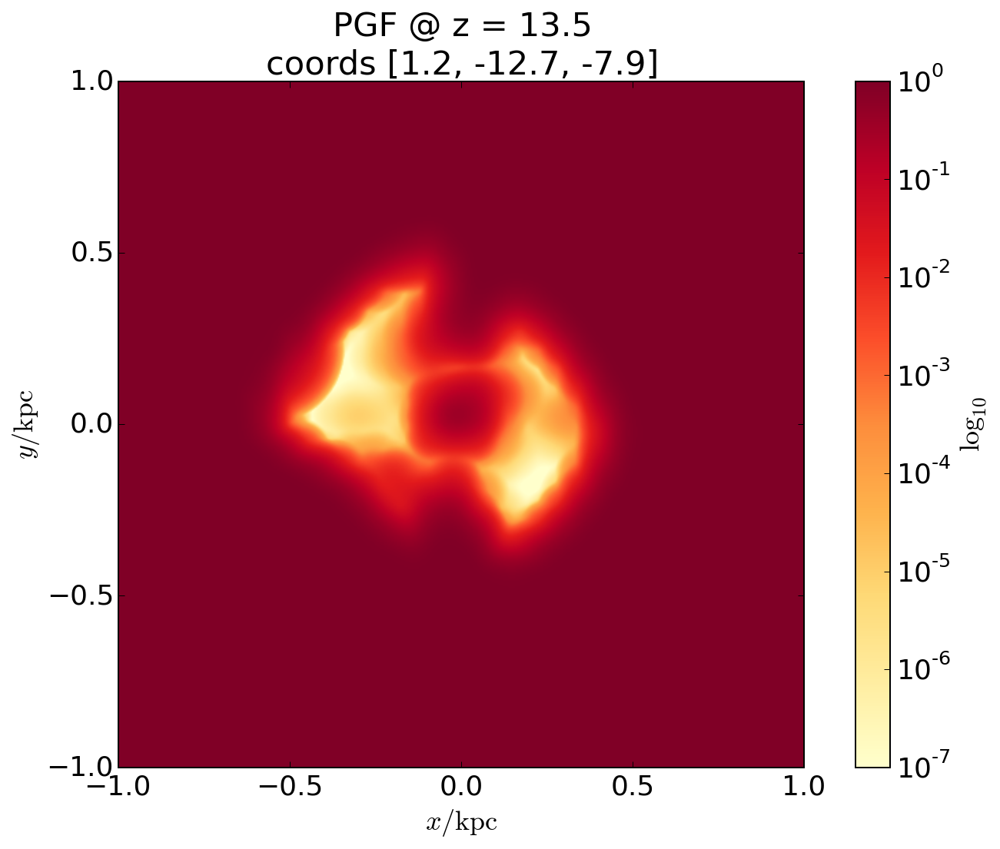

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


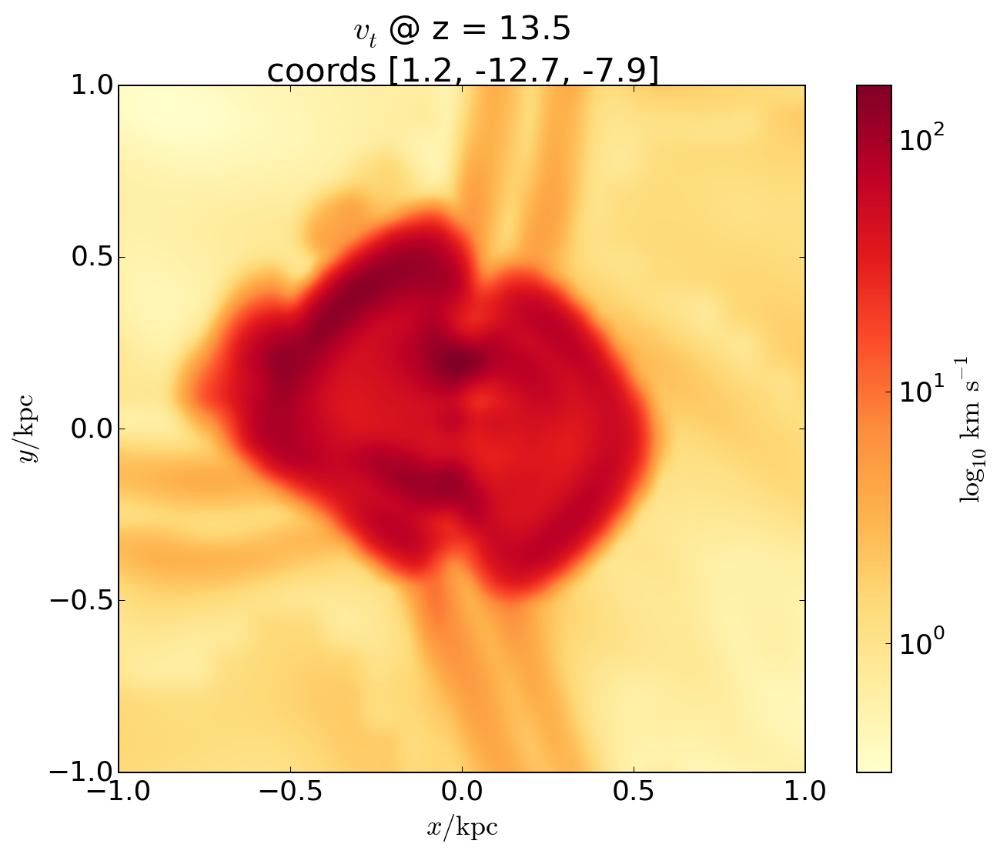

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


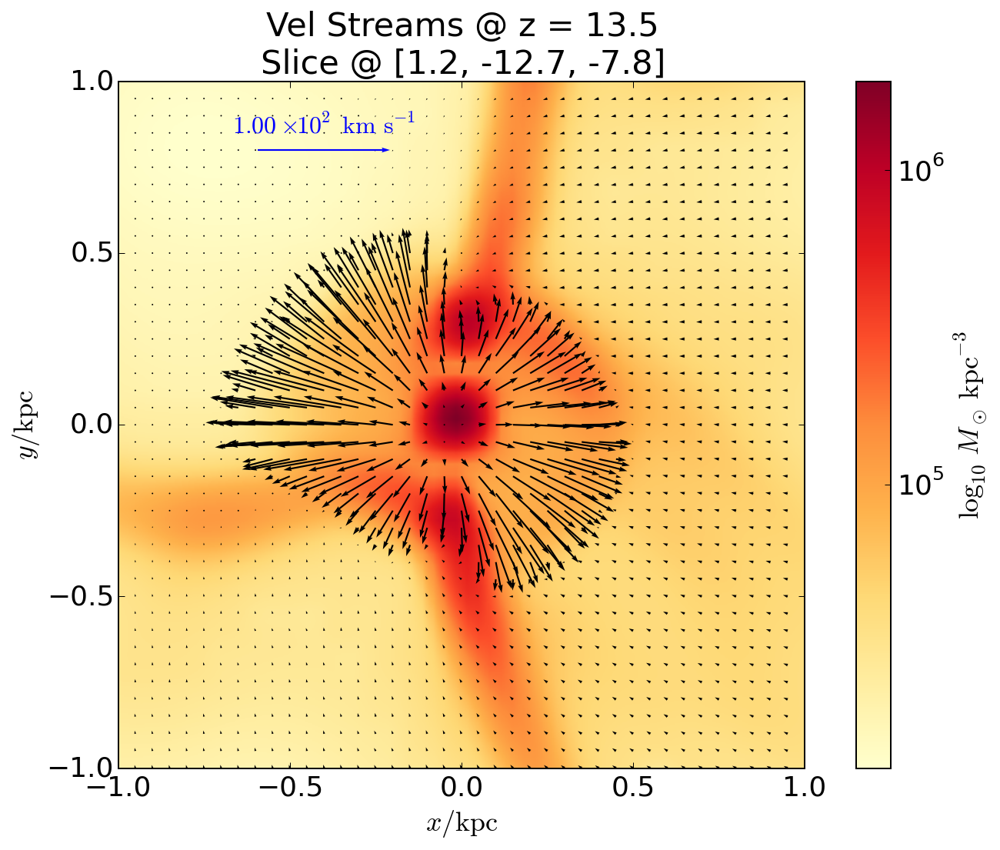

In [57]:
coords2= [1.2,-12.7,-7.9] # NOTE WE ARE TRANSLATING... HENCE THE - SIGN...
smallbox='2 kpc'
with pynbody.transformation.translate(snBlast,coords2):
    titleStr = "Z @ z = %.1lf" % z + "\ncoords %s"%str(coords2)
    sph.image(snBlast.g,qty="metal",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=False, log=True, vmax=1,vmin=1e-7,
              approximate_fast=False,title=titleStr,filename="Z @ z = %.1lf" % z + " @ %s" % str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()
    titleStr = "PGF @ z = %.1lf" % z + "\ncoords %s"%str(coords2)
    sph.image(snBlast.g,qty="pgf",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=False, log=True, vmin=1e-7,
              approximate_fast=False,title=titleStr,filename="PGF @ z = %.1lf" % z + " @ %s"%str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()
    titleStr = "$v_{t}$ @ z = %.1lf" % z + "\ncoords %s"%str(coords2)
    sph.image(snBlast.g,qty="tv",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=False, log=True, 
              approximate_fast=False,title=titleStr,filename="v_t @ z = %.1lf" % z + " @ %s"%str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()
    titleStr = "Vel Streams @ z = %.1lf" % z + "\nSlice @ %s" % str(coords)
    sph.velocity_image(s.g,width=smallbox,cmap="YlOrRd", mode='quiver',key_color='blue',key_length='100 km s**-1',
              vector_resolution=40,title=titleStr,filename="Vel Streams @ z = %.1lf" % z + " @ %s" % str(coords)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


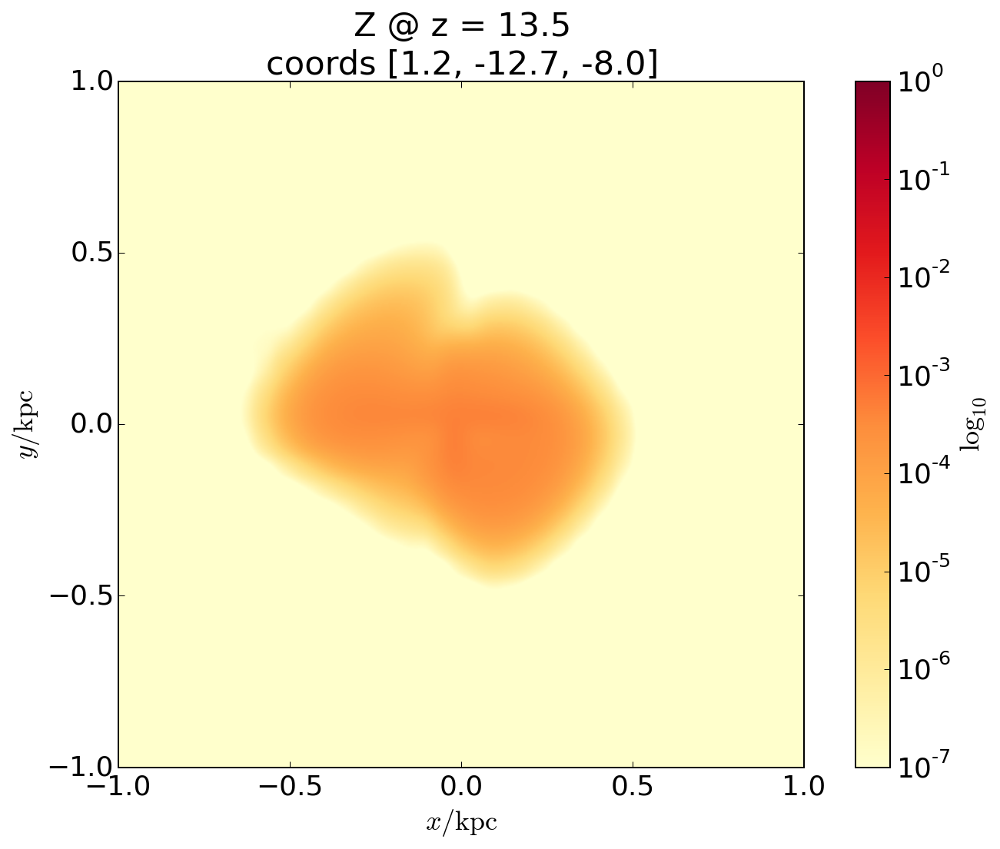

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


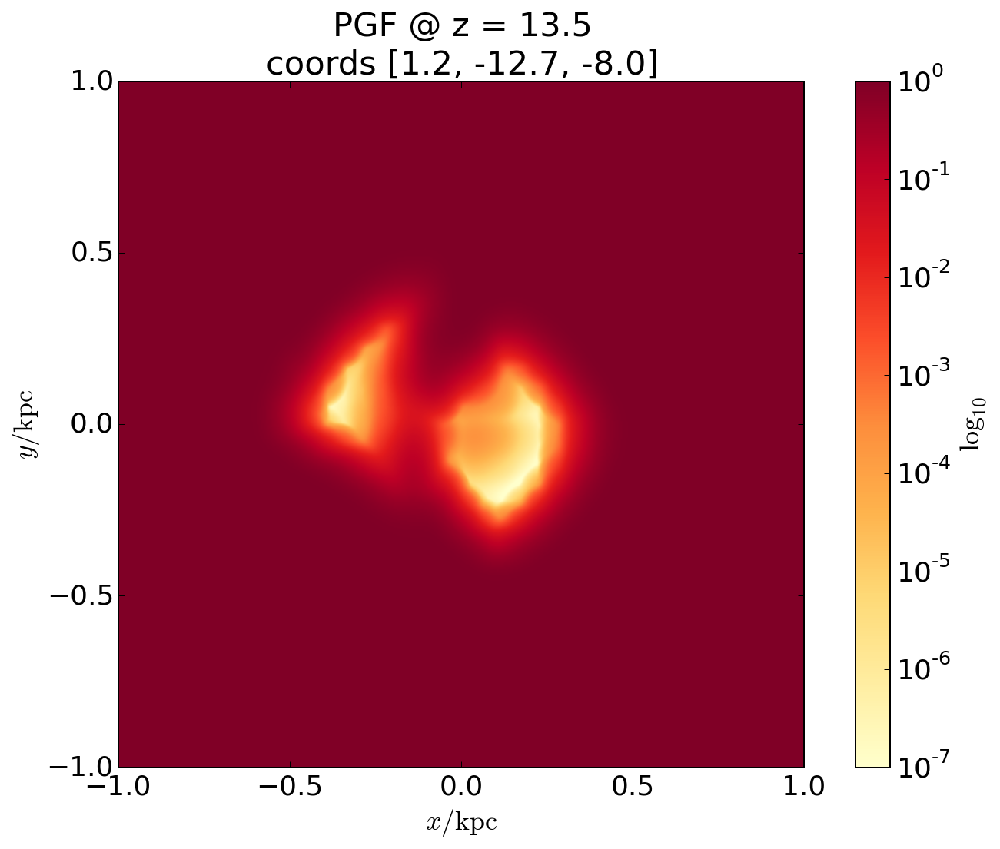

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


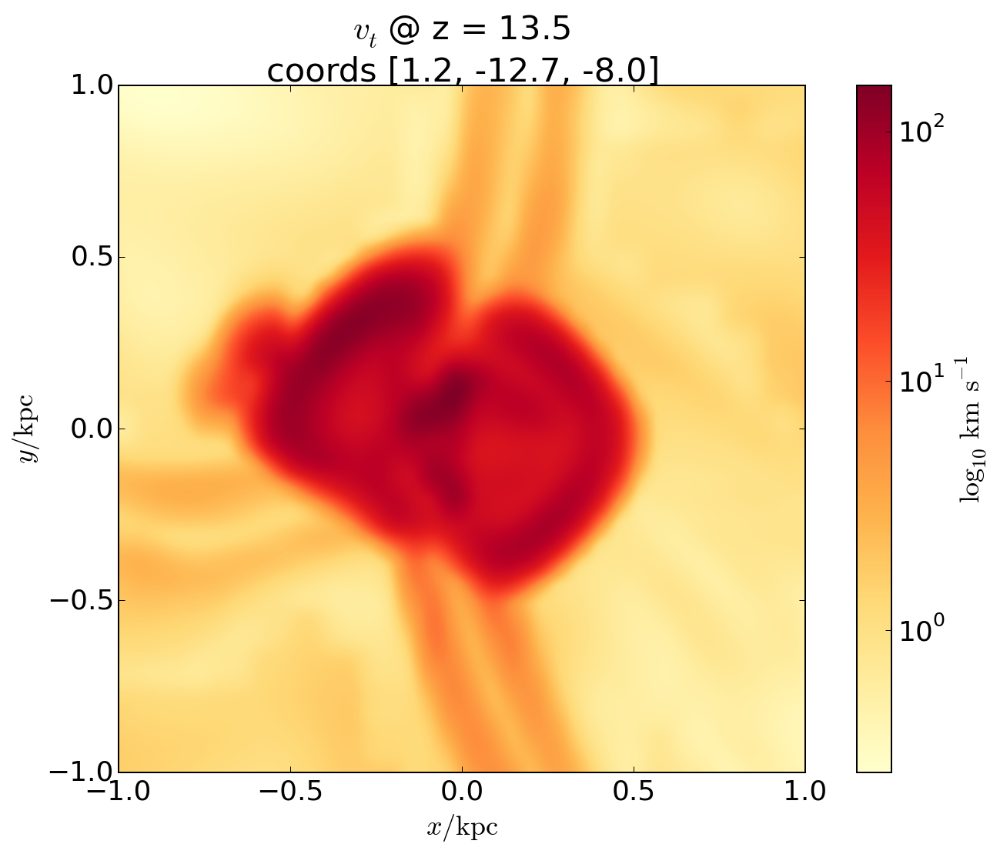

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


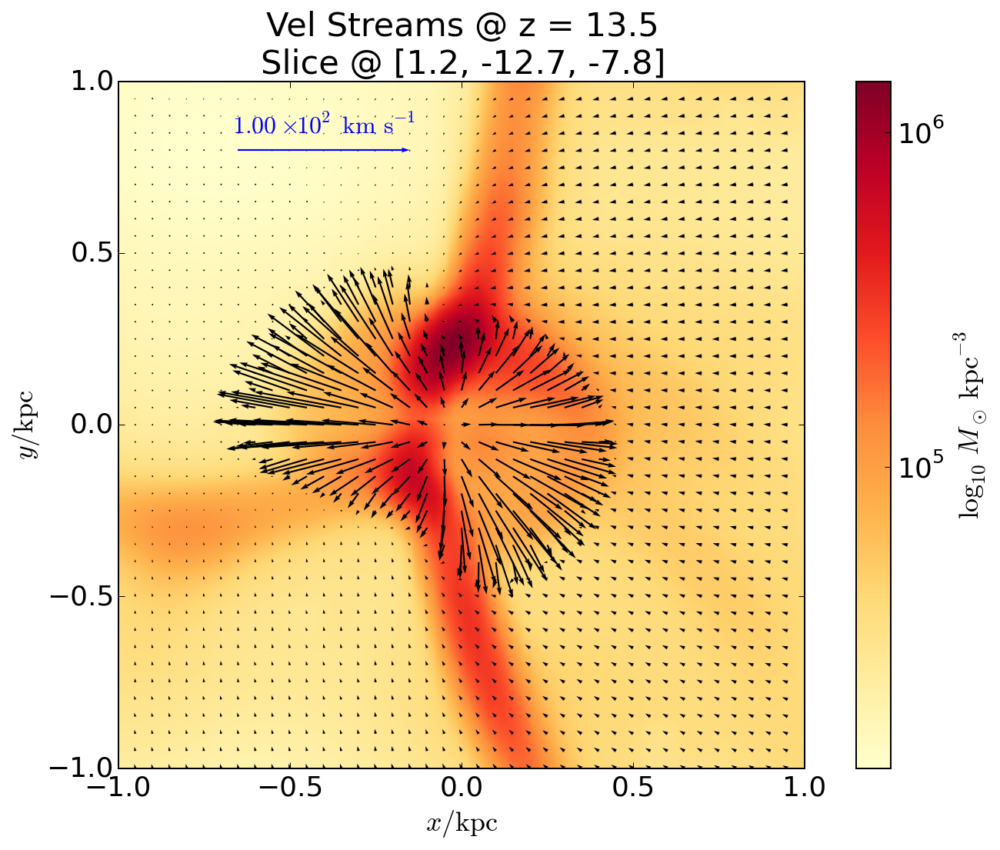

In [58]:
coords2= [1.2,-12.7,-8.0] # NOTE WE ARE TRANSLATING... HENCE THE - SIGN...
smallbox='2 kpc'
with pynbody.transformation.translate(snBlast,coords2):
    titleStr = "Z @ z = %.1lf" % z + "\ncoords %s"%str(coords2)
    sph.image(snBlast.g,qty="metal",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=False, log=True, vmax=1,vmin=1e-7,
              approximate_fast=False,title=titleStr,filename="Z @ z = %.1lf" % z + " @ %s" % str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()
    titleStr = "PGF @ z = %.1lf" % z + "\ncoords %s"%str(coords2)
    sph.image(snBlast.g,qty="pgf",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=False, log=True, vmin=1e-7,
              approximate_fast=False,title=titleStr,filename="PGF @ z = %.1lf" % z + " @ %s"%str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()
    titleStr = "$v_{t}$ @ z = %.1lf" % z + "\ncoords %s"%str(coords2)
    sph.image(snBlast.g,qty="tv",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=False, log=True, 
              approximate_fast=False,title=titleStr,filename="v_t @ z = %.1lf" % z + " @ %s"%str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()
    titleStr = "Vel Streams @ z = %.1lf" % z + "\nSlice @ %s" % str(coords)
    sph.velocity_image(s.g,width=smallbox,cmap="YlOrRd", mode='quiver',key_color='blue',key_length='100 km s**-1',
              vector_resolution=40,title=titleStr,filename="Vel Streams @ z = %.1lf" % z + " @ %s" % str(coords)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


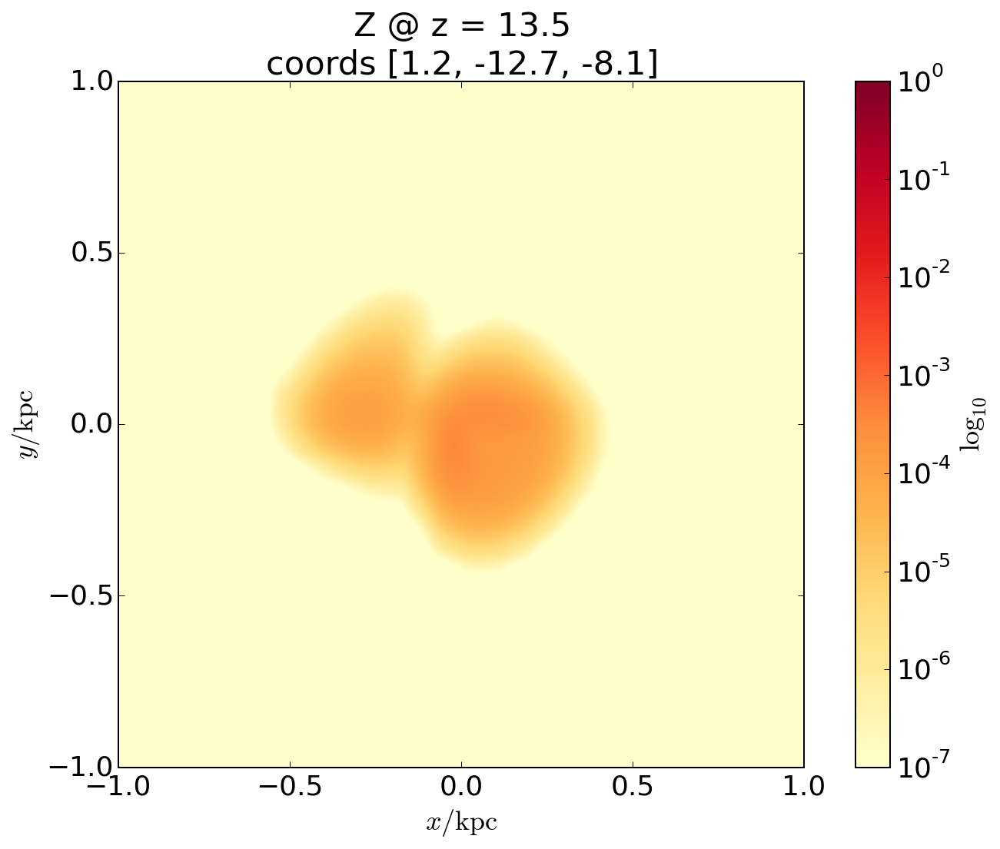

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


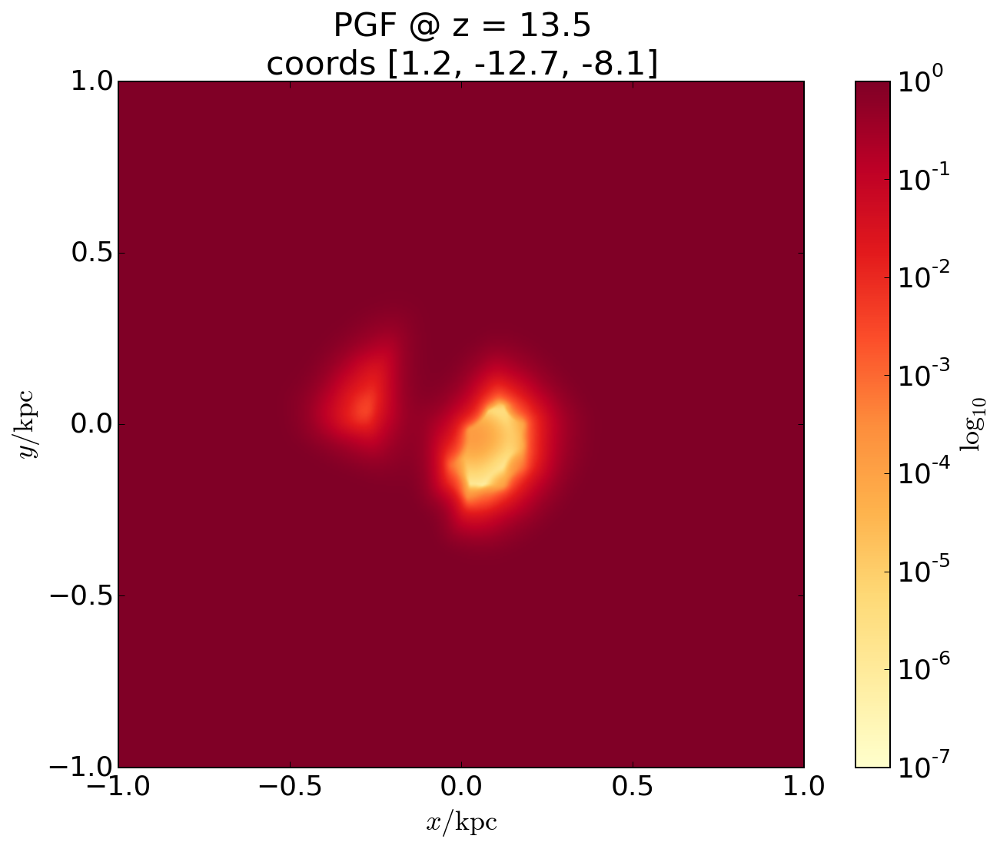

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


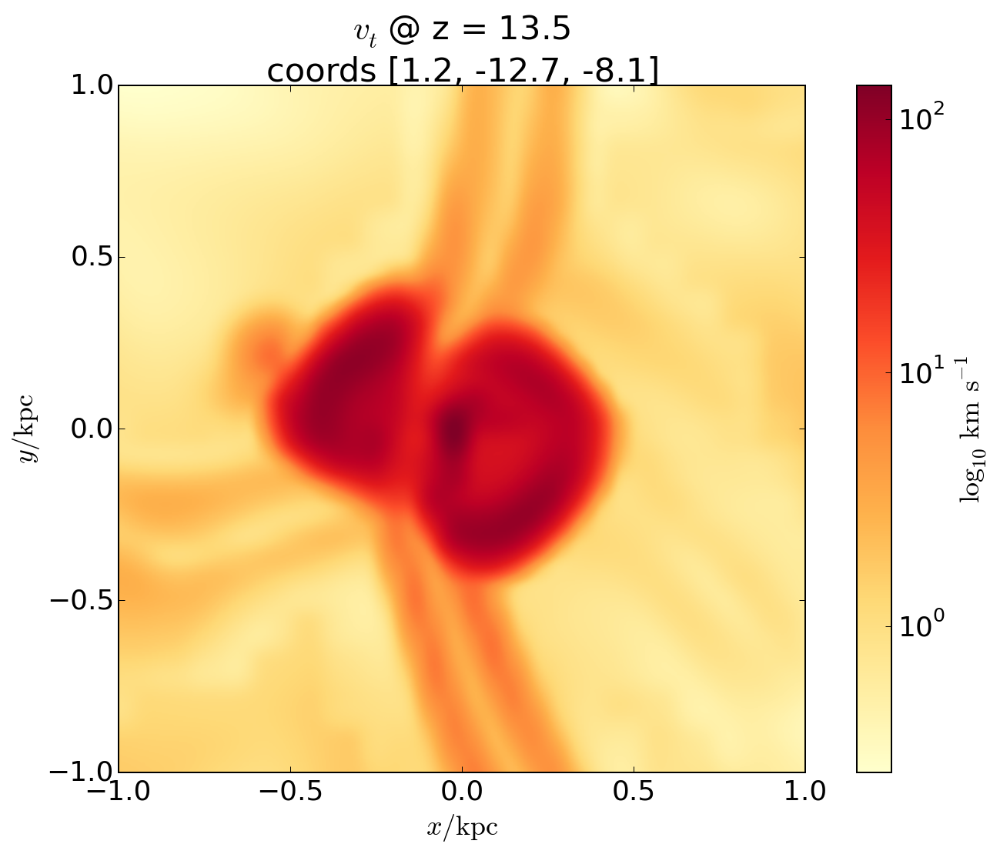

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


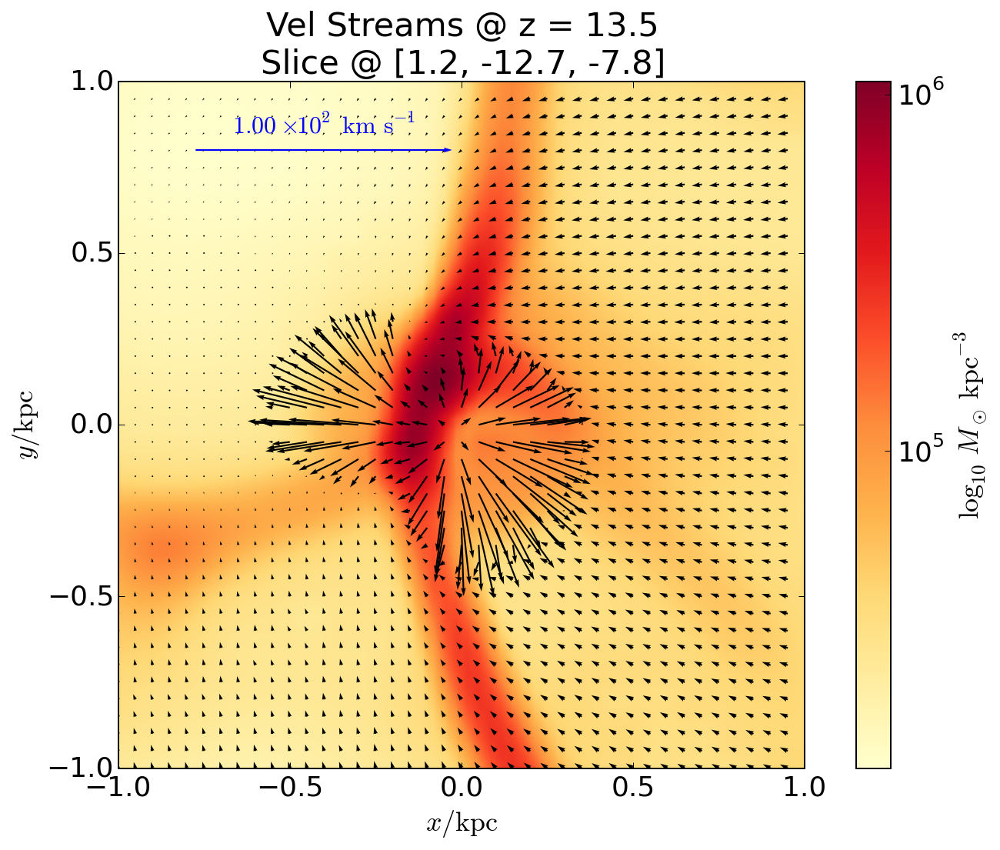

In [59]:
coords2= [1.2,-12.7,-8.1] # NOTE WE ARE TRANSLATING... HENCE THE - SIGN...
smallbox='2 kpc'
with pynbody.transformation.translate(snBlast,coords2):
    titleStr = "Z @ z = %.1lf" % z + "\ncoords %s"%str(coords2)
    sph.image(snBlast.g,qty="metal",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=False, log=True, vmax=1,vmin=1e-7,
              approximate_fast=False,title=titleStr,filename="Z @ z = %.1lf" % z + " @ %s" % str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()
    titleStr = "PGF @ z = %.1lf" % z + "\ncoords %s"%str(coords2)
    sph.image(snBlast.g,qty="pgf",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=False, log=True, vmin=1e-7,
              approximate_fast=False,title=titleStr,filename="PGF @ z = %.1lf" % z + " @ %s"%str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()
    titleStr = "$v_{t}$ @ z = %.1lf" % z + "\ncoords %s"%str(coords2)
    sph.image(snBlast.g,qty="tv",width=smallbox,cmap="YlOrRd", denoise=True ,av_z=False, log=True, 
              approximate_fast=False,title=titleStr,filename="v_t @ z = %.1lf" % z + " @ %s"%str(coords2)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()
    titleStr = "Vel Streams @ z = %.1lf" % z + "\nSlice @ %s" % str(coords)
    sph.velocity_image(s.g,width=smallbox,cmap="YlOrRd", mode='quiver',key_color='blue',key_length='100 km s**-1',
              vector_resolution=40,title=titleStr,filename="Vel Streams @ z = %.1lf" % z + " @ %s" % str(coords)+".png"); #vmin=0.006, vmax=1.0,
    plt.show()

In [54]:
gc.collect()

0

INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...
INFO:pynbody.sph:Rendering image on 32 threads...


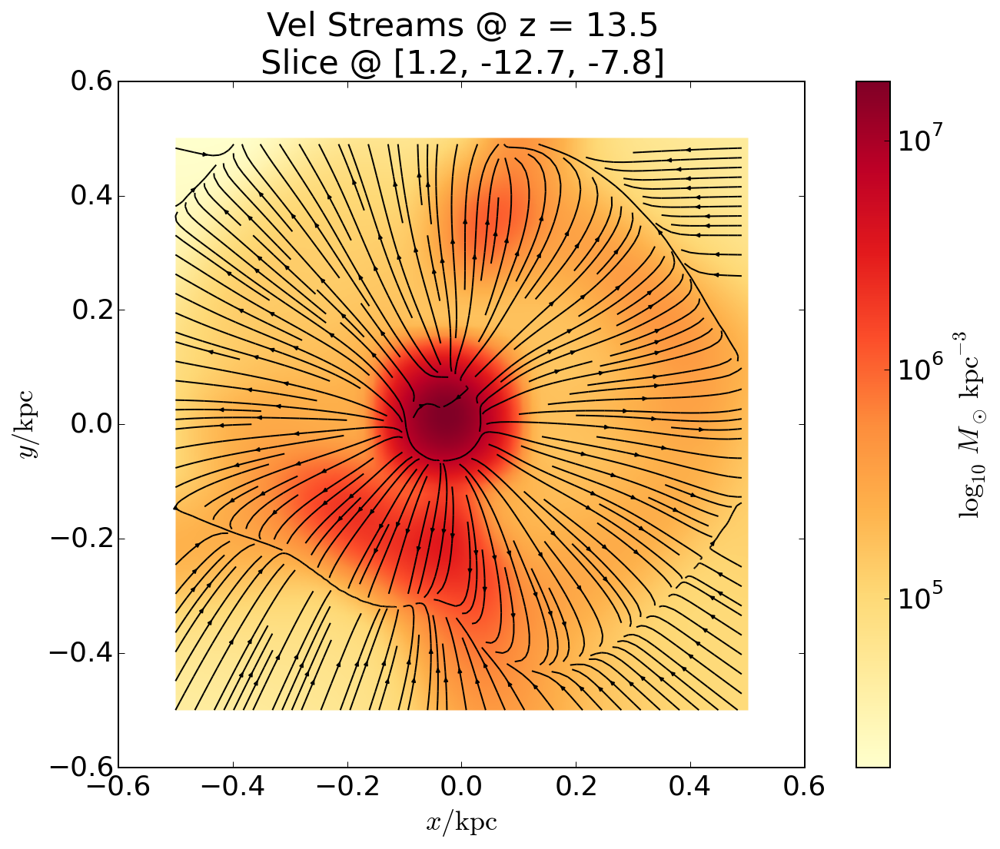

In [30]:
with pynbody.transformation.translate(snBlast,coords):
    titleStr = "Vel Streams @ z = %.1lf" % z + "\nSlice @ %s" % str(coords)
    sph.velocity_image(snBlast.g,width="1 kpc",cmap="YlOrRd", mode='stream',
              density=2.0, vector_resolution=100,title=titleStr); #vmin=0.006, vmax=1.0,

#Next output step